In [1]:
# Analyses results from all models

In [2]:
from rdkit import Chem, DataStructs
from rdkit.Chem import AllChem
from scipy import stats
from rdkit.Chem import rdMolDescriptors as rdmd
from rdkit.Chem.Scaffolds import MurckoScaffold
import pandas as pd
from tqdm import tqdm
import time
import numpy as np
from scipy.spatial.distance import cdist
from sklearn.cluster import MiniBatchKMeans
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import matthews_corrcoef,confusion_matrix, roc_auc_score, roc_curve
import seaborn as sns

In [3]:
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import classification_report
from sklearn.metrics import balanced_accuracy_score

def check_heirarchial(assay, method, true, pred, prob):
    
    y_true = true
    y_pred = pred
    y_prob=  prob
    
    conf_matrix = confusion_matrix(y_true, y_pred)
    #print(conf_matrix)
    
    #print(classification_report(y_true, y_pred))
    
    ba= balanced_accuracy_score(y_true, y_pred)
    #print('balanced_accuracy_score ',ba)
    
    mcc=matthews_corrcoef(y_true, y_pred)
    #print('matthews_corrcoef ',mcc)
    # Sensitivity, hit rate, recall, or true positive rate
    
    f1= f1_score(y_true, y_pred, average='binary')
    precision = precision_score(y_true, y_pred, average='binary')
    
    #print('F1 Toxic', f1)
    #print('precision', precision)
    
    Specificity = conf_matrix[0,0]/(conf_matrix[0,0]+conf_matrix[0,1])
    # Specificity or true negative rate
    Sensitivity = conf_matrix[1,1]/(conf_matrix[1,0]+conf_matrix[1,1]) 
    
    #print( 'Sensitivity', Sensitivity)
    #print( 'Specificity', Specificity)
    AUC = roc_auc_score(y_true, y_prob)
    #print('AUC-ROC ',AUC)    
    # calculate roc curves
    best_model_fpr, best_model_tpr, _ = roc_curve(y_true, y_prob)   
    
    
    row=[assay, method, f1, precision, Sensitivity, Specificity, ba, mcc, AUC]
    metrics_list.append(row)
    
    return metrics_list

In [4]:
from sklearn.linear_model import LogisticRegression
from io import StringIO
import sys
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import StratifiedKFold

In [5]:
metrics_list_1 = pd.read_csv("BROAD_Assays/All_metrics_merger_heirarchial.csv").reset_index(drop=True)
metrics_list_1


,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC
0,178_684,CP,0.571429,0.571429,0.571429,0.853659,0.712544,0.425087,0.731707
1,178_684,Distance Based Merger,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.848432
2,178_684,Ensemble Averaged,0.521739,0.666667,0.428571,0.926829,0.677700,0.418479,0.677700
3,178_684,Heirarchial Model,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.770035
4,178_684,MFP,0.560000,0.636364,0.500000,0.902439,0.701220,0.438262,0.808362
...,...,...,...,...,...,...,...,...,...
440,93_259,CP,0.400000,0.375000,0.428571,0.736842,0.582707,0.158970,0.751880
441,93_259,Distance Based Merger,0.461538,0.500000,0.428571,0.842105,0.635338,0.284961,0.766917
442,93_259,Ensemble Averaged,0.307692,0.333333,0.285714,0.789474,0.537594,0.079156,0.537594
443,93_259,Heirarchial Model,0.250000,1.000000,0.142857,1.000000,0.571429,0.329502,0.473684


In [6]:
metrics_list_2 = pd.read_csv("./Public_Dataset/All_metrics_merger_heirarchial.csv").reset_index(drop=True)
metrics_list_2

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC
0,1117304,CP,0.350000,0.466667,0.280000,0.849057,0.564528,0.152817,0.555472
1,1117304,Distance Based Merger,0.360000,0.360000,0.360000,0.698113,0.529057,0.058113,0.541132
2,1117304,Ensemble Averaged,0.000000,0.000000,0.000000,0.962264,0.481132,-0.111414,0.481132
3,1117304,Heirarchial Model,0.525000,0.381818,0.840000,0.358491,0.599245,0.203143,0.579245
4,1117304,MFP,0.235294,0.444444,0.160000,0.905660,0.532830,0.095910,0.520755
...,...,...,...,...,...,...,...,...,...
435,Novartis2,CP,0.125000,0.142857,0.111111,0.647059,0.379085,-0.259376,0.431373
436,Novartis2,Distance Based Merger,0.307692,0.500000,0.222222,0.882353,0.552288,0.137890,0.575163
437,Novartis2,Ensemble Averaged,0.000000,0.000000,0.000000,0.941176,0.470588,-0.145521,0.470588
438,Novartis2,Heirarchial Model,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,0.431373


In [7]:
metrics_list = pd.concat([metrics_list_1, metrics_list_2]).reset_index(drop=True)
metrics_list.to_csv("All177assays_metrics.csv", index=False)
metrics_list

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC
0,178_684,CP,0.571429,0.571429,0.571429,0.853659,0.712544,0.425087,0.731707
1,178_684,Distance Based Merger,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.848432
2,178_684,Ensemble Averaged,0.521739,0.666667,0.428571,0.926829,0.677700,0.418479,0.677700
3,178_684,Heirarchial Model,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.770035
4,178_684,MFP,0.560000,0.636364,0.500000,0.902439,0.701220,0.438262,0.808362
...,...,...,...,...,...,...,...,...,...
880,Novartis2,CP,0.125000,0.142857,0.111111,0.647059,0.379085,-0.259376,0.431373
881,Novartis2,Distance Based Merger,0.307692,0.500000,0.222222,0.882353,0.552288,0.137890,0.575163
882,Novartis2,Ensemble Averaged,0.000000,0.000000,0.000000,0.941176,0.470588,-0.145521,0.470588
883,Novartis2,Heirarchial Model,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,0.431373


In [8]:
assay_compounds_stats_list_1 = pd.read_csv("./BROAD_Assays/assay_compounds_stats_list_bothsideundersampling.csv")
assay_compounds_stats_list_1
assay_compounds_stats_list_2 = pd.read_csv("./Public_Dataset/assay_compounds_stats_list_bothsideundersampling.csv")
assay_compounds_stats_list_2

,assay,total,actives,inactives,ratio
0,588458,448,112,336,0.250000
1,588334,528,132,396,0.250000
2,2642,764,191,573,0.250000
3,2156,568,142,426,0.250000
4,2330,328,82,246,0.250000
...,...,...,...,...,...
83,720504,128,96,32,0.750000
84,720532,301,210,91,0.697674
85,1159524,880,220,660,0.250000
86,1117304,386,126,260,0.326425


In [9]:
assay_compounds_stats_list = pd.concat([assay_compounds_stats_list_1, assay_compounds_stats_list_2]).reset_index(drop=True)
assay_compounds_stats_list

,assay,total,actives,inactives,ratio
0,178_684,272,68,204,0.250000
1,180_686,204,51,153,0.250000
2,183_604,180,45,135,0.250000
3,184_606,312,78,234,0.250000
4,185_665,120,30,90,0.250000
...,...,...,...,...,...
172,720504,128,96,32,0.750000
173,720532,301,210,91,0.697674
174,1159524,880,220,660,0.250000
175,1117304,386,126,260,0.326425


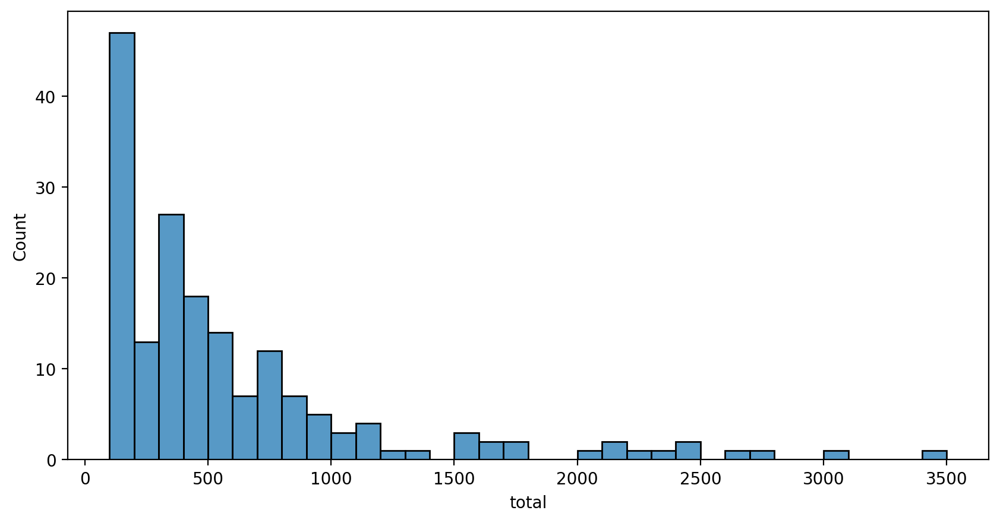

In [10]:
fig, ax = plt.subplots(figsize=(10, 5), dpi=200)
g= sns.histplot(data=assay_compounds_stats_list, x="total", binwidth=100)

In [105]:
#Relation between Model Performance and Label Data
metrics_list_compared_data = pd.merge(metrics_list, assay_compounds_stats_list, on="assay")
metrics_list_compared_data["ratio"] = metrics_list_compared_data["actives"]/metrics_list_compared_data["total"]
metrics_list_compared_data

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC,total,actives,inactives,ratio
0,178_684,CP,0.571429,0.571429,0.571429,0.853659,0.712544,0.425087,0.731707,272,68,204,0.250000
1,178_684,Distance Based Merger,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.848432,272,68,204,0.250000
2,178_684,Ensemble Averaged,0.521739,0.666667,0.428571,0.926829,0.677700,0.418479,0.677700,272,68,204,0.250000
3,178_684,Heirarchial Model,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.770035,272,68,204,0.250000
4,178_684,MFP,0.560000,0.636364,0.500000,0.902439,0.701220,0.438262,0.808362,272,68,204,0.250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
880,Novartis2,CP,0.125000,0.142857,0.111111,0.647059,0.379085,-0.259376,0.431373,129,47,82,0.364341
881,Novartis2,Distance Based Merger,0.307692,0.500000,0.222222,0.882353,0.552288,0.137890,0.575163,129,47,82,0.364341
882,Novartis2,Ensemble Averaged,0.000000,0.000000,0.000000,0.941176,0.470588,-0.145521,0.470588,129,47,82,0.364341
883,Novartis2,Heirarchial Model,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,0.431373,129,47,82,0.364341


In [106]:
import decimal
    
def drange(x, y, jump):
  while x < y:
    yield float(x)
    x += decimal.Decimal(jump)
    
    
counts=[]
for k in drange(0, 1, 0.01):
    counts.append(k)

    

def calc_below_threshold(x1):
    counts=[]
    for k in drange(0, 1, 0.01):
        count=0
        for i in x1 :
           if i > k :
            count = count + 1
        counts.append(count) 
    return(counts)
       # print(count)

In [107]:
def return_counts(method, metric):
    
    results_counts = calc_below_threshold(metrics_list_compared_data[metrics_list_compared_data["method"]==method][metric].values)
    return(results_counts)

#results_CP_counts= calc_below_threshold(metrics_list_compared_data[metrics_list_compared_data["method"]=="CP"]["AUC"].values)
#results_MFP_counts= calc_below_threshold(metrics_list_compared_data[metrics_list_compared_data["method"]=="MFP"]["AUC"].values)
#results_Ensemble_Averaged_counts= calc_below_threshold(metrics_list_compared_data[metrics_list_compared_data["method"]=="Ensemble Averaged"]["AUC"].values)
#results_Distance_Based_Merger_counts= calc_below_threshold(metrics_list_compared_data[metrics_list_compared_data["method"]=="Distance Based Merger"]["AUC"].values)


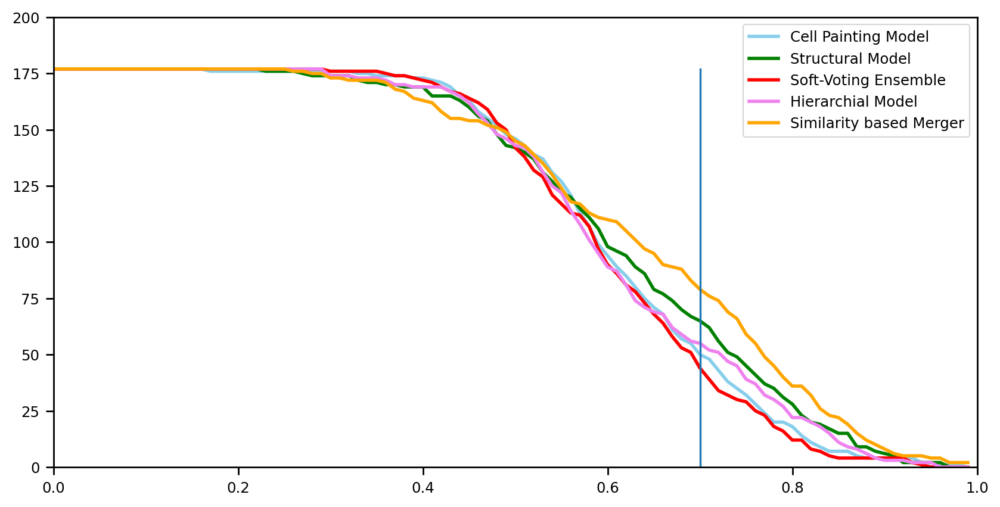

In [108]:
df=pd.DataFrame({'counts':counts,
                 'results_CP_counts':return_counts("CP", "AUC"),
                 'results_MFP_counts':return_counts("MFP", "AUC"), 
                 'results_Ensemble_Averaged_counts':return_counts("Ensemble Averaged", "AUC"),
                 'results_Heirarchial_Model_counts':return_counts("Heirarchial Model", "AUC"),
                 'results_Distance_Based_Merger_counts':return_counts("Distance Based Merger", "AUC")
                })
 
fig, ax = plt.subplots(figsize=(10, 5), dpi=200)

# multiple line plots
plt.plot( 'counts', 'results_CP_counts', data=df, marker='', color='skyblue', linewidth=2, label="Cell Painting Model")
plt.plot( 'counts', 'results_MFP_counts', data=df, marker='', color='green', linewidth=2, label="Structural Model")
plt.plot( 'counts', 'results_Ensemble_Averaged_counts', data=df, marker='', color='red', linewidth=2, label="Soft-Voting Ensemble")
plt.plot( 'counts', 'results_Heirarchial_Model_counts', data=df, marker='', color='violet', linewidth=2, label="Hierarchial Model")
plt.plot( 'counts', 'results_Distance_Based_Merger_counts', data=df, marker='', color='orange', linewidth=2,  label="Similarity based Merger")
plt.plot((0.7, 0.7), (0.7, 177)) 
plt.xlim((0,1))
plt.ylim((0,200))
# show legend
plt.legend()
# show graph
plt.show()

In [109]:
df[df.counts>0.70]

,counts,results_CP_counts,results_MFP_counts,results_Ensemble_Averaged_counts,results_Heirarchial_Model_counts,results_Distance_Based_Merger_counts
70,0.70,50,65,44,55,79
71,0.71,48,62,39,52,76
72,0.72,43,56,34,51,74
73,0.73,38,51,32,47,69
74,0.74,35,49,30,45,66
75,0.75,32,45,29,39,59
76,0.76,28,41,25,37,55
77,0.77,24,37,23,32,49
78,0.78,20,35,18,30,45
79,0.79,20,31,16,27,40


In [13]:
(79-65)/65

0.2153846153846154

In [17]:
(79-44)/44

0.7954545454545454

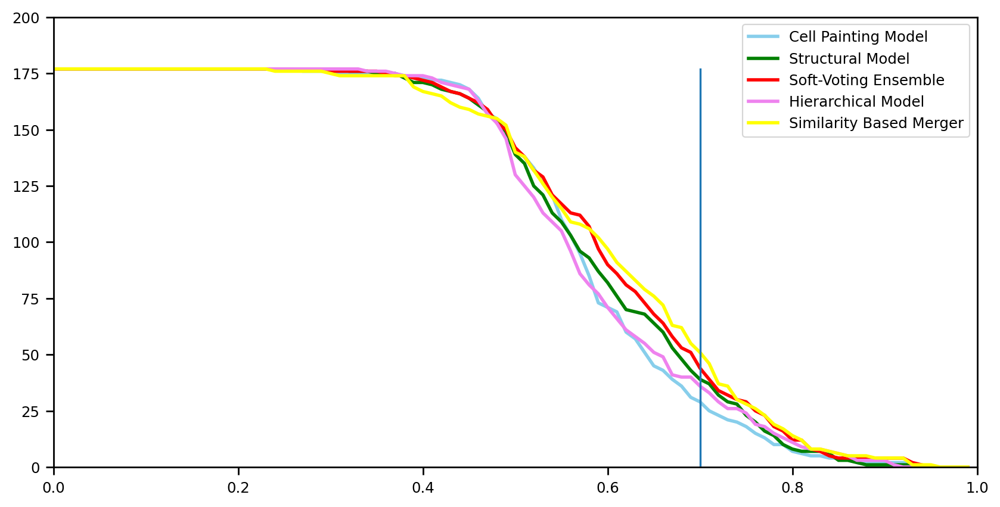

In [110]:
df=pd.DataFrame({'counts':counts,
                 'results_CP_counts':return_counts("CP", "ba"),
                 'results_MFP_counts':return_counts("MFP", "ba"), 
                 'results_Ensemble_Averaged_counts':return_counts("Ensemble Averaged", "ba"),
                 'results_Heirarchial_Model_counts':return_counts("Heirarchial Model", "ba"),
                 'results_Distance_Based_Merger_counts':return_counts("Distance Based Merger", "ba")
                })
 
fig, ax = plt.subplots(figsize=(10, 5), dpi=200)
# multiple line plots
plt.plot( 'counts', 'results_CP_counts', data=df, marker='', color='skyblue', linewidth=2, label="Cell Painting Model")
plt.plot( 'counts', 'results_MFP_counts', data=df, marker='', color='green', linewidth=2, label="Structural Model")
plt.plot( 'counts', 'results_Ensemble_Averaged_counts', data=df, marker='', color='red', linewidth=2, label="Soft-Voting Ensemble")
plt.plot( 'counts', 'results_Heirarchial_Model_counts', data=df, marker='', color='violet', linewidth=2, label="Hierarchical Model")
plt.plot( 'counts', 'results_Distance_Based_Merger_counts', data=df, marker='', color='yellow', linewidth=2,  label="Similarity Based Merger")
plt.plot((0.7, 0.7), (0.7, 177)) 
plt.xlim((0,1))
plt.ylim((0,200))
# show legend
plt.legend()
# show graph
plt.show()

In [111]:
df[df.counts>0.70]

,counts,results_CP_counts,results_MFP_counts,results_Ensemble_Averaged_counts,results_Heirarchial_Model_counts,results_Distance_Based_Merger_counts
70,0.70,29,39,44,36,51
71,0.71,25,37,39,33,46
72,0.72,23,32,34,29,37
73,0.73,21,29,32,26,36
74,0.74,20,28,30,26,30
75,0.75,18,23,29,24,28
76,0.76,15,20,25,19,26
77,0.77,13,16,23,18,23
78,0.78,10,14,18,15,19
79,0.79,10,10,16,13,17


In [112]:
metrics_list_compared_data

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC,total,actives,inactives,ratio
0,178_684,CP,0.571429,0.571429,0.571429,0.853659,0.712544,0.425087,0.731707,272,68,204,0.250000
1,178_684,Distance Based Merger,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.848432,272,68,204,0.250000
2,178_684,Ensemble Averaged,0.521739,0.666667,0.428571,0.926829,0.677700,0.418479,0.677700,272,68,204,0.250000
3,178_684,Heirarchial Model,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.770035,272,68,204,0.250000
4,178_684,MFP,0.560000,0.636364,0.500000,0.902439,0.701220,0.438262,0.808362,272,68,204,0.250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
880,Novartis2,CP,0.125000,0.142857,0.111111,0.647059,0.379085,-0.259376,0.431373,129,47,82,0.364341
881,Novartis2,Distance Based Merger,0.307692,0.500000,0.222222,0.882353,0.552288,0.137890,0.575163,129,47,82,0.364341
882,Novartis2,Ensemble Averaged,0.000000,0.000000,0.000000,0.941176,0.470588,-0.145521,0.470588,129,47,82,0.364341
883,Novartis2,Heirarchial Model,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,0.431373,129,47,82,0.364341


In [113]:
def return_values(method, metric):
    
    results_values = metrics_list_compared_data[metrics_list_compared_data["method"]==method][metric].values
    return(results_values)


In [114]:
df_AUC = pd.DataFrame()
df_AUC["Cell Painting Model"] = return_values("CP", "AUC")
df_AUC["Structural Model"] = return_values("MFP", "AUC")
df_AUC["Soft-Voting Ensemble"] = return_values("Ensemble Averaged", "AUC")
df_AUC["Hierarchical Model"] = return_values("Heirarchial Model", "AUC")
df_AUC["Distance Based Merger"] = return_values("Distance Based Merger", "AUC")


In [115]:
len(df_AUC[df_AUC["Cell Painting Model"]<df_AUC["Structural Model"]])

96

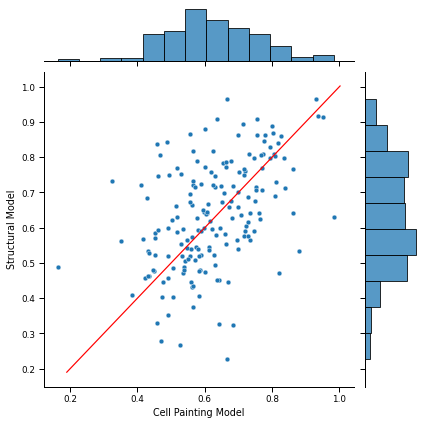

In [116]:
g  = sns.jointplot(data=df_AUC, x="Cell Painting Model", y="Structural Model")
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r')
plt.show()

In [117]:
len(df_AUC[df_AUC["Soft-Voting Ensemble"]<=df_AUC["Hierarchical Model"]])

107

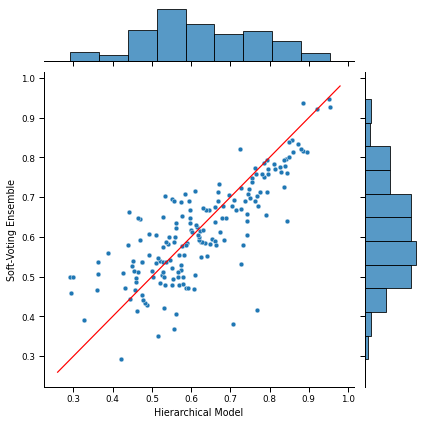

In [118]:
g  = sns.jointplot(data=df_AUC, x="Hierarchical Model", y="Soft-Voting Ensemble")
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r')
plt.show()

In [119]:
len(df_AUC[df_AUC["Distance Based Merger"]<df_AUC["Hierarchical Model"]])

52

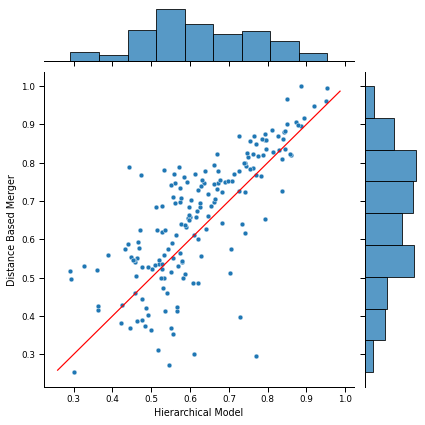

In [120]:
g  = sns.jointplot(data=df_AUC, x="Hierarchical Model", y="Distance Based Merger")
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r')
plt.show()

In [121]:
len(df_AUC[df_AUC["Soft-Voting Ensemble"]<df_AUC["Distance Based Merger"]])

132

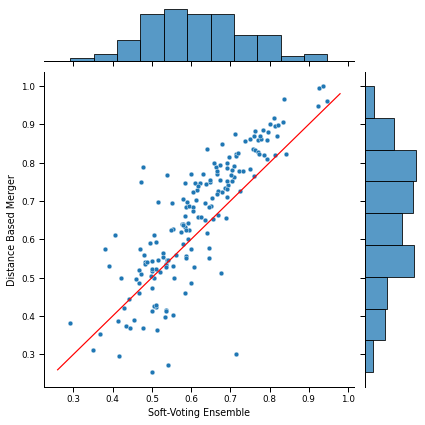

In [122]:
g  = sns.jointplot(data=df_AUC, x="Soft-Voting Ensemble", y="Distance Based Merger")
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r')
plt.show()

In [123]:
#Balanced Accuracy

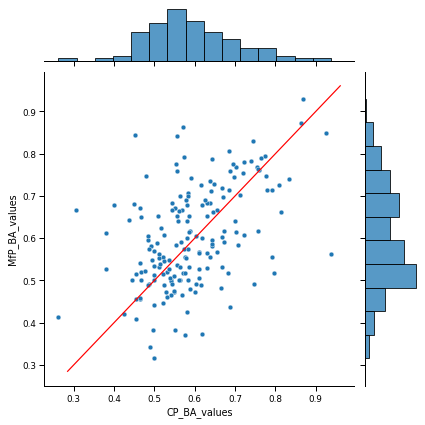

In [124]:
df = pd.DataFrame()
df["CP_BA_values"] = return_values("CP", "ba")
df["MfP_BA_values"] = return_values("MFP", "ba")
df["Heirarchial_Model_BA_values"] = return_values("Heirarchial Model", "ba")
df["Ensemble_Averaged_BA_values"] = return_values("Ensemble Averaged", "ba")
df["Distance_Based_Merger_BA_values"] = return_values("Distance Based Merger", "ba")

g  = sns.jointplot(data=df, x="CP_BA_values", y="MfP_BA_values")
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r')
plt.show()

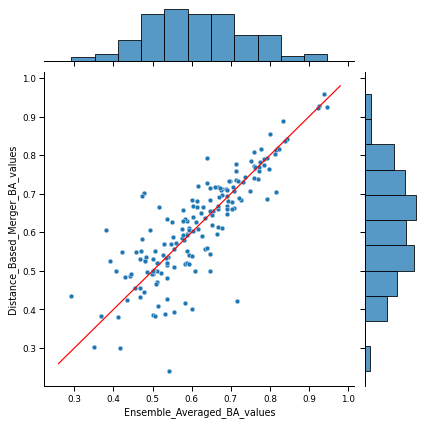

In [125]:
g  = sns.jointplot(data=df, x="Ensemble_Averaged_BA_values", y="Distance_Based_Merger_BA_values")
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r')
plt.show()

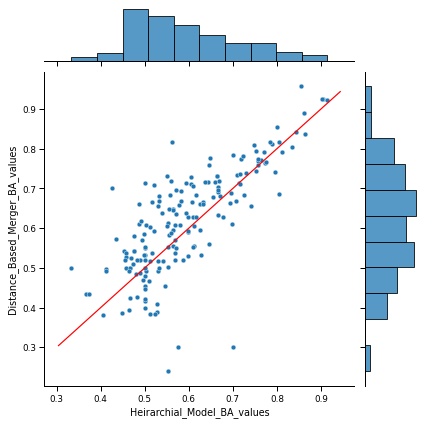

In [126]:
g  = sns.jointplot(data=df, x="Heirarchial_Model_BA_values", y="Distance_Based_Merger_BA_values")
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r')
plt.show()

In [127]:
df

,CP_BA_values,MfP_BA_values,Heirarchial_Model_BA_values,Ensemble_Averaged_BA_values,Distance_Based_Merger_BA_values
0,0.712544,0.701220,0.713415,0.677700,0.713415
1,0.617742,0.600000,0.556452,0.600000,0.683871
2,0.555556,0.759259,0.666667,0.814815,0.703704
3,0.863032,0.873005,0.905585,0.926197,0.926197
4,0.500000,0.500000,0.555556,0.472222,0.583333
...,...,...,...,...,...
172,0.517241,0.623563,0.540230,0.635057,0.637931
173,0.555556,0.652778,0.593254,0.672619,0.714286
174,0.654762,0.666667,0.654762,0.702381,0.678571
175,0.511029,0.562500,0.411765,0.444853,0.492647


In [128]:
df.describe()

,CP_BA_values,MfP_BA_values,Heirarchial_Model_BA_values,Ensemble_Averaged_BA_values,Distance_Based_Merger_BA_values
count,177.000000,177.000000,177.000000,177.000000,177.000000
mean,0.591977,0.601907,0.593836,0.615439,0.616972
std,0.110318,0.119384,0.118529,0.124326,0.133125
min,0.262500,0.315789,0.333333,0.292308,0.239583
25%,0.520512,0.515146,0.500000,0.516667,0.519481
50%,0.576754,0.587302,0.568750,0.603846,0.612994
75%,0.654762,0.684307,0.666667,0.697581,0.712754
max,0.937500,0.930037,0.914652,0.947083,0.958333


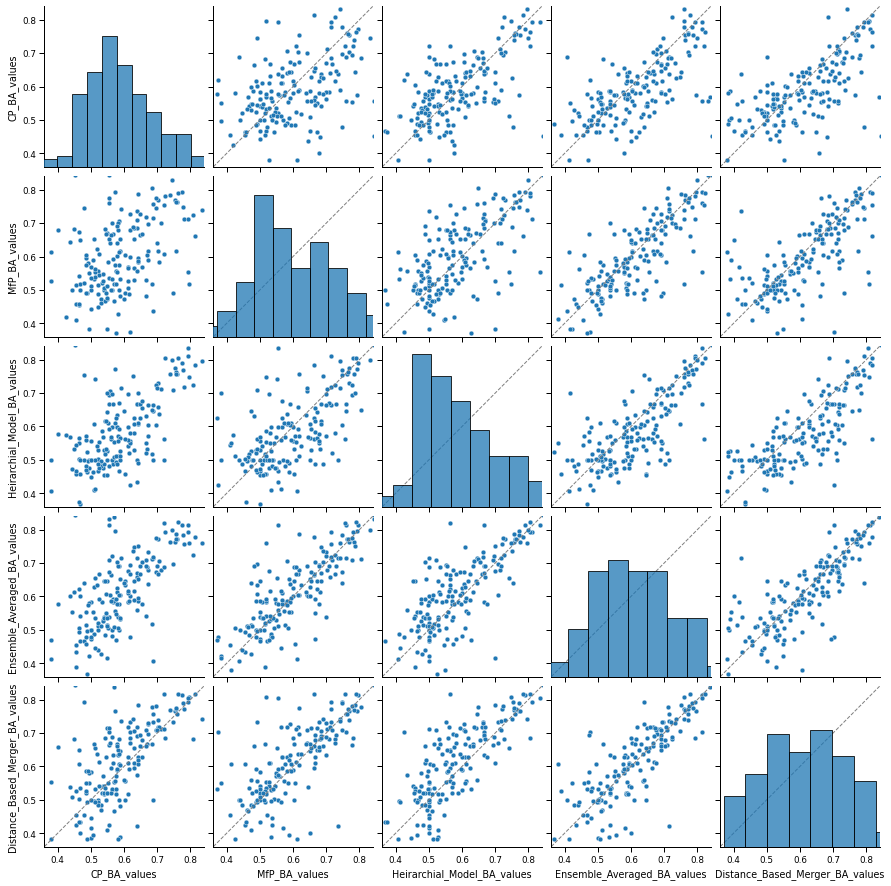

In [129]:
#without regression
g=sns.pairplot(df, kind="scatter")
l=(0.36,0.84)

counter=0
for ax in g.axes.ravel():
    counter=counter+1
    if counter not in [1, 6, 11, 16]:
        ax.axline(xy1=(0.36,0.36), slope=1, ls='--', linewidth=1, c='grey')
    
for ax in g.axes.ravel():
    ax.set_xlim(0.36,0.84)
    ax.set_ylim(0.36,0.84)

    

plt.show()

In [130]:


def return_limit_count(limit, method, metric):
    arr = return_values(method, metric)
    arr = arr>limit
    metric_bool = np.where(arr)
    metric_bool = {e for l in metric_bool for e in l}
    return metric_bool

  

0.5


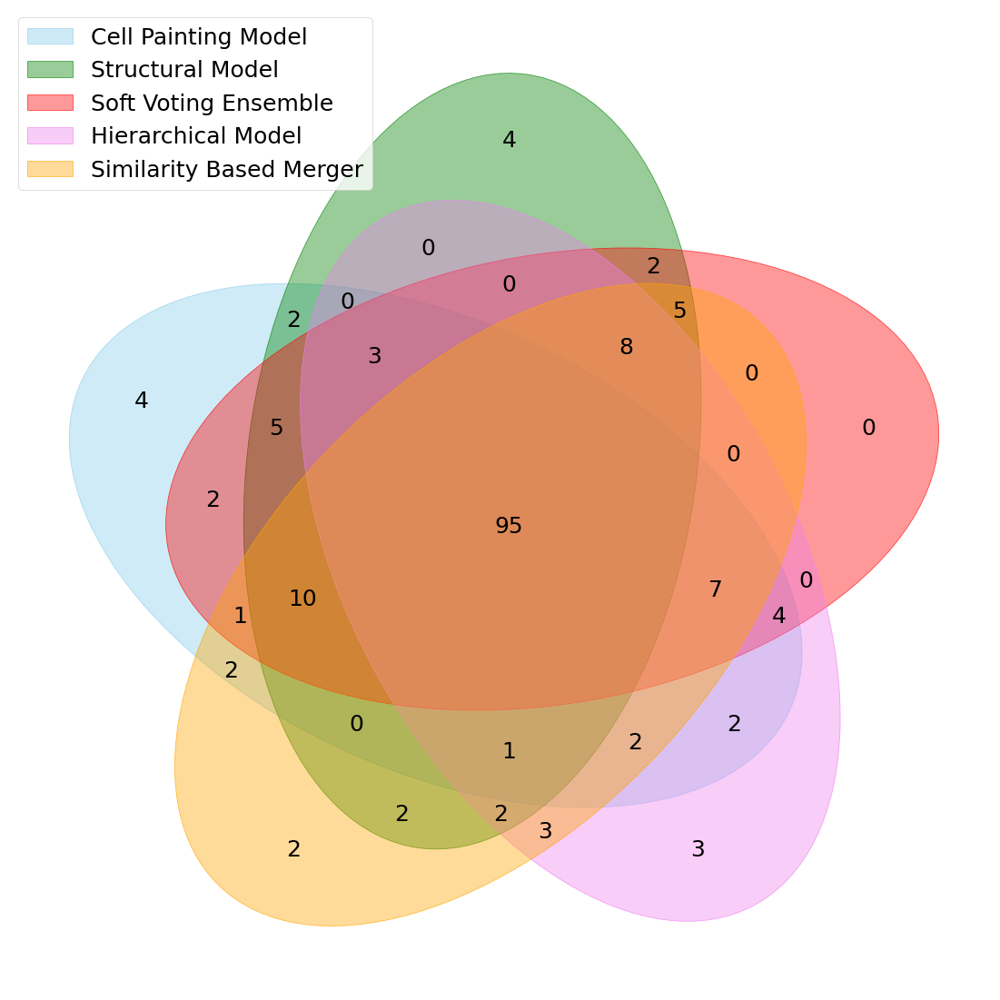

0.6


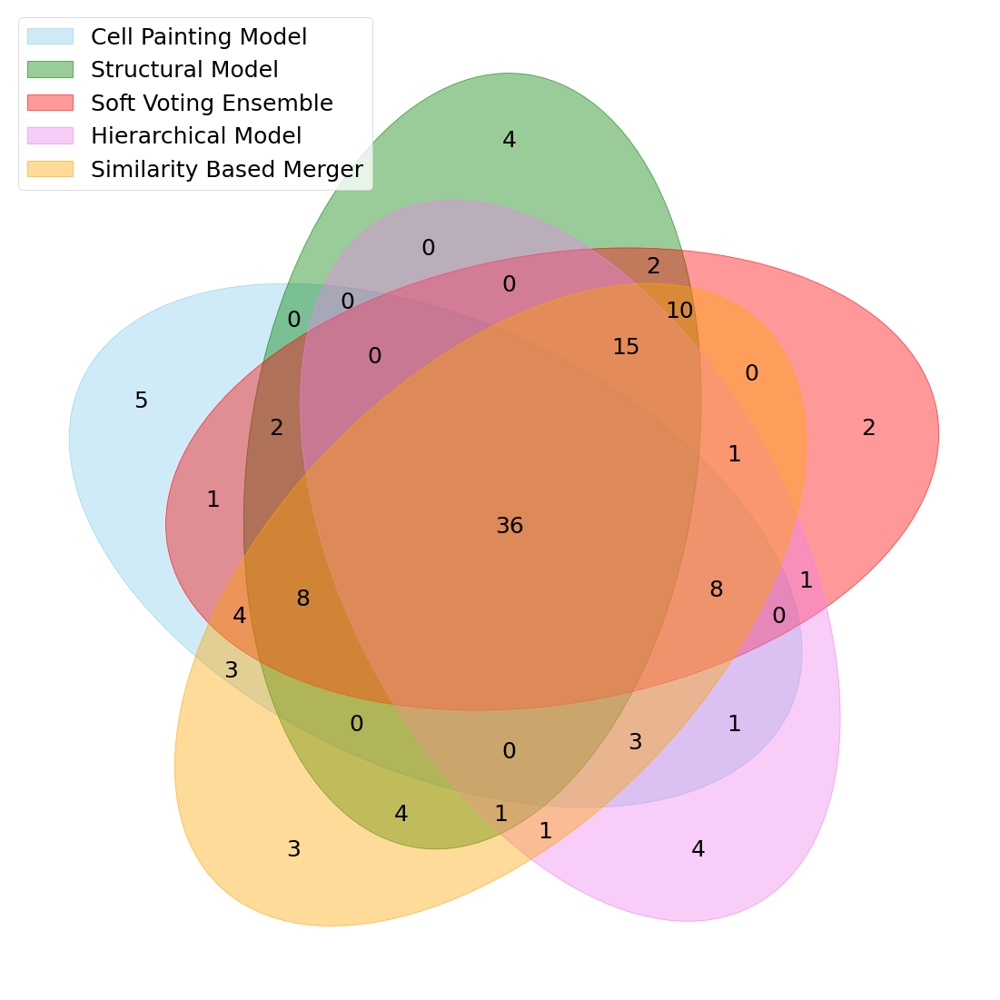

0.7


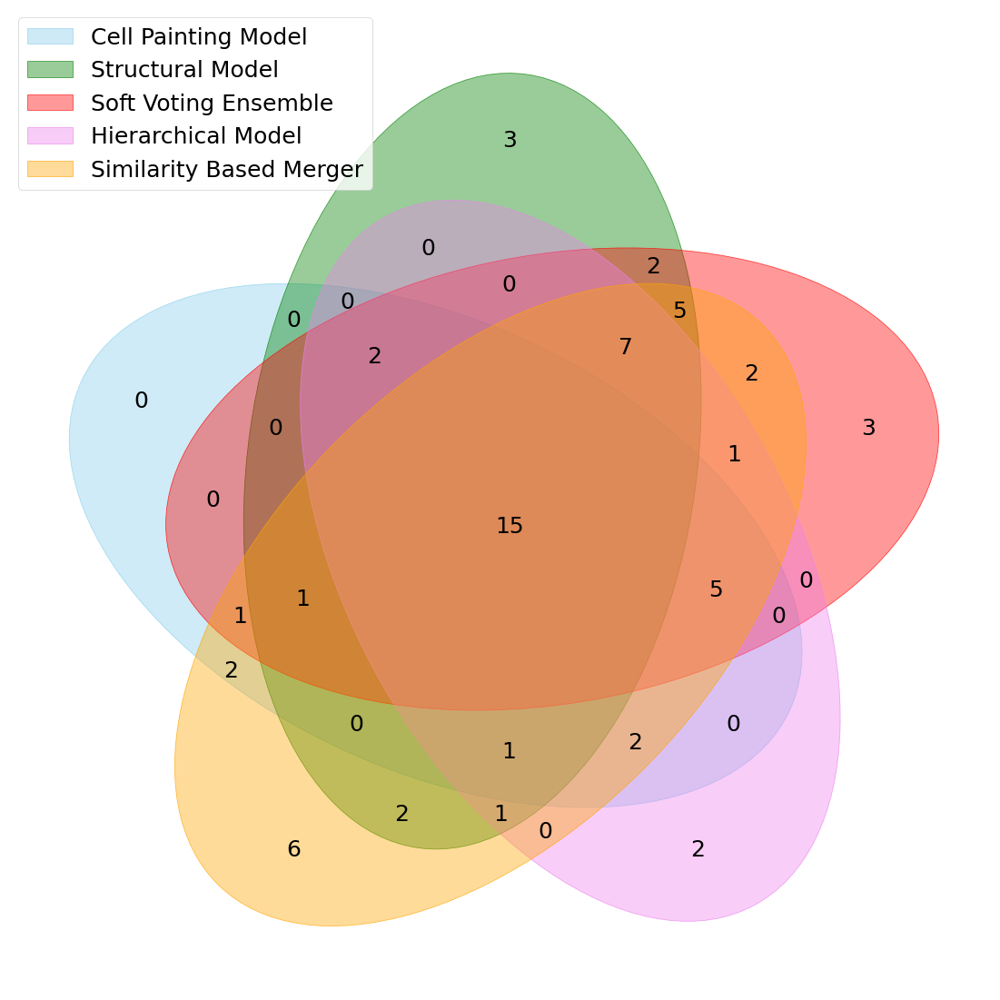

In [131]:
from venn import venn
limit_list=[0.5, 0.6, 0.7]

for limit in limit_list:
    
    
    print(limit)

    bool_CP = return_limit_count(limit, "CP", "ba")
    
    bool_MFP = return_limit_count(limit, "MFP", "ba")
    
    bool_Distance_Based_Merger = return_limit_count(limit, "Distance Based Merger", "ba")
    
    bool_Ensemble_Averaged = return_limit_count(limit, "Ensemble Averaged", "ba")
    
    bool_Heirarchial_model = return_limit_count(limit, "Heirarchial Model", "ba")
    
    ba_venn = {
    "Cell Painting Model": bool_CP,
    "Structural Model": bool_MFP,
    "Soft Voting Ensemble": bool_Ensemble_Averaged,
    "Hierarchical Model": bool_Heirarchial_model,
    "Similarity Based Merger": bool_Distance_Based_Merger,
    }
    
    cmap = ["skyblue",
    "green",
    "red",
    "violet",
    "orange"]


    venn(ba_venn, cmap=cmap, fontsize=25, legend_loc="upper left", figsize=(20, 20))
    
    plt.show()


0.5


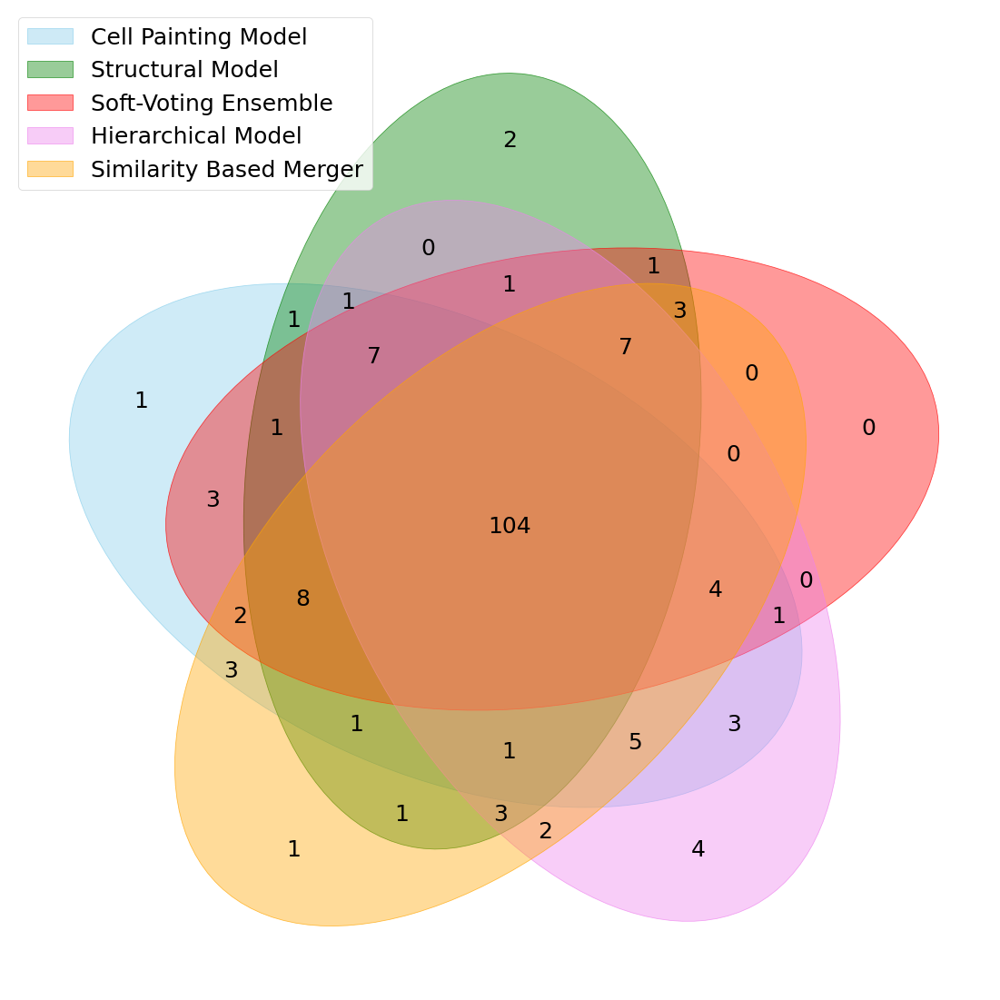

0.6


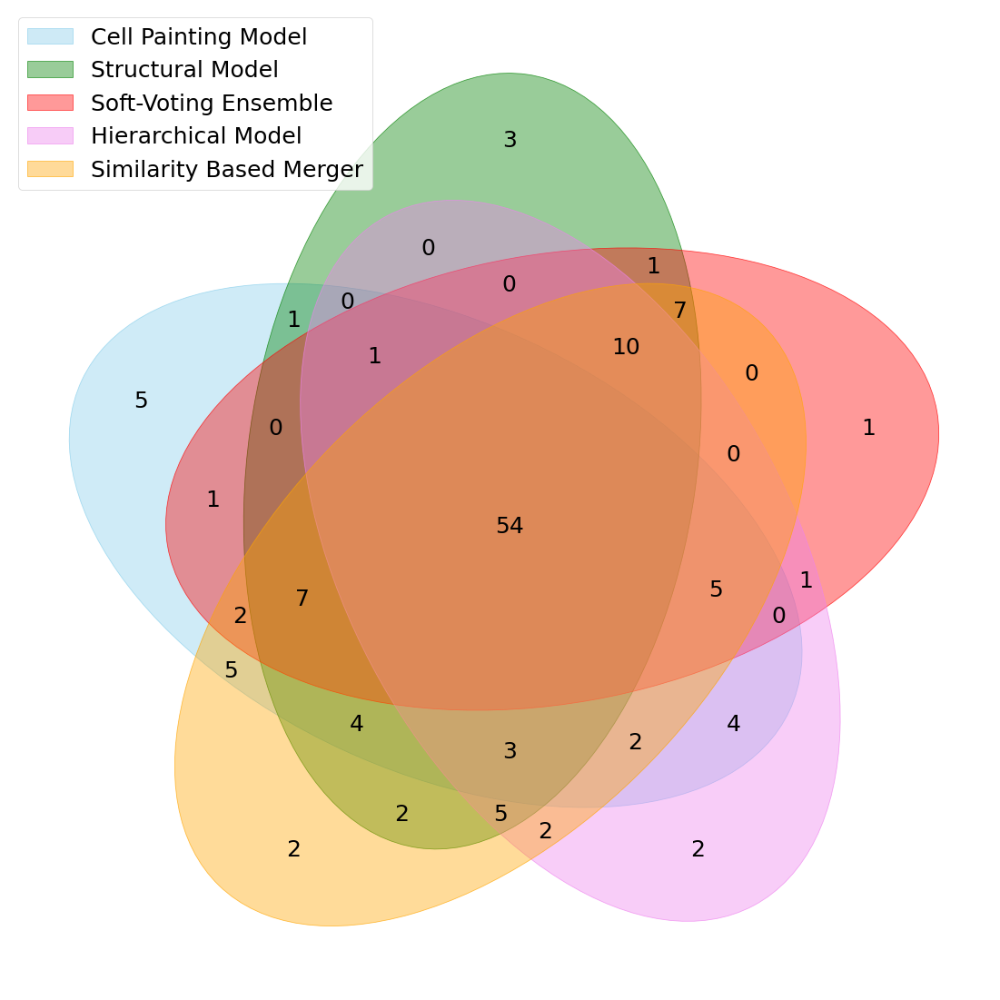

0.7


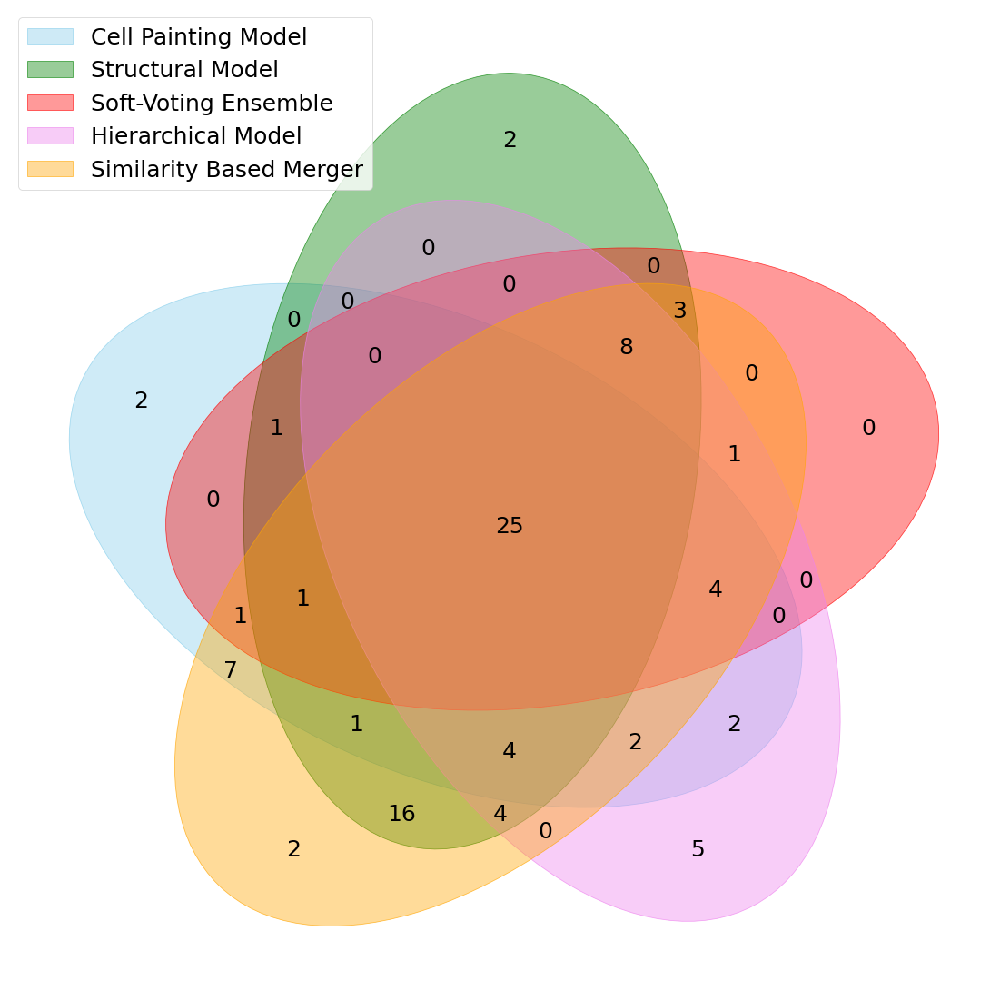

In [132]:
from venn import venn
limit_list=[0.5, 0.6, 0.7]

for limit in limit_list:
    print(limit)

    bool_CP = return_limit_count(limit, "CP", "AUC")
    bool_MFP = return_limit_count(limit, "MFP", "AUC")
    bool_Distance_Based_Merger = return_limit_count(limit, "Distance Based Merger", "AUC")
    bool_Ensemble_Averaged = return_limit_count(limit, "Ensemble Averaged", "AUC")
    bool_Heirarchial_model = return_limit_count(limit, "Heirarchial Model", "AUC")
    
    AUC_venn = {
    "Cell Painting Model": bool_CP,
    "Structural Model": bool_MFP,
    "Soft-Voting Ensemble": bool_Ensemble_Averaged,
    "Hierarchical Model": bool_Heirarchial_model,
    "Similarity Based Merger": bool_Distance_Based_Merger,
    }
    
    cmap = ["skyblue",
    "green",
    "red",
    "violet",
    "orange"]


    venn(AUC_venn, cmap=cmap, fontsize=25, legend_loc="upper left", figsize=(20, 20))
    
    #leg = plt.legend()
    #ax.get_legend().remove()
    plt.show()


In [133]:
metrics_list_compared_data[metrics_list_compared_data["ratio"]>0.66]

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC,total,actives,inactives,ratio
595,504332,CP,0.760956,0.743191,0.779592,0.195122,0.487357,-0.026721,0.505077,1632,1224,408,0.750000
596,504332,Distance Based Merger,0.605327,0.744048,0.510204,0.475610,0.492907,-0.012303,0.503982,1632,1224,408,0.750000
597,504332,Ensemble Averaged,0.806026,0.748252,0.873469,0.121951,0.497710,-0.005994,0.497710,1632,1224,408,0.750000
598,504332,Heirarchial Model,0.574939,0.722222,0.477551,0.451220,0.464385,-0.061752,0.459756,1632,1224,408,0.750000
599,504332,MFP,0.747967,0.744939,0.751020,0.231707,0.491364,-0.017416,0.486461,1632,1224,408,0.750000
605,504339,CP,0.122137,0.571429,0.068376,0.863636,0.466006,-0.107529,0.451049,805,583,222,0.724224
606,504339,Distance Based Merger,0.650485,0.752809,0.572650,0.500000,0.536325,0.065117,0.545843,805,583,222,0.724224
607,504339,Ensemble Averaged,0.441718,0.782609,0.307692,0.772727,0.540210,0.079333,0.540210,805,583,222,0.724224
608,504339,Heirarchial Model,0.739837,0.705426,0.777778,0.136364,0.457071,-0.095881,0.452700,805,583,222,0.724224
609,504339,MFP,0.522222,0.746032,0.401709,0.636364,0.519037,0.034766,0.521368,805,583,222,0.724224


In [134]:
for metric in [ "ba", "AUC"]:
    comparison_df = metrics_list_compared_data[["assay","method", "total", "ratio", metric]]
    
    
    
    '''improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
    improvement_df = improvement_df.sort_values(by='Ensemble Averaged', ascending=False).reset_index(drop=True)
    
    fig, ax = plt.subplots(figsize=(10,20), dpi= 80)
    
    ax.hlines(y=improvement_df.index, xmin=0, xmax=1, color='gray', alpha=0.7, linewidth=1, linestyles='dashdot')
    ax.scatter(y=improvement_df.index, x=improvement_df["MFP"], s=75, color='firebrick', alpha=0.7)
    ax.scatter(y=improvement_df.index, x=improvement_df["CP"], s=75, color='blue', alpha=0.7, marker="X")
    ax.scatter(y=improvement_df.index, x=improvement_df["Ensemble Averaged"], s=75, color='skyblue', alpha=0.7,marker="s")
    ax.scatter(y=improvement_df.index, x=improvement_df["Distance Based Merger"], s=75, color='orange', alpha=1.0, marker="^")

    # Title, Label, Ticks and Ylim
    ax.set_title('Performance over 92 assays', fontdict={'size':15})
    ax.set_xlabel(metric)
    ax.set_yticks(improvement_df.index)
    ax.set_yticklabels(improvement_df.assay.str.title(), fontdict={'horizontalalignment': 'right'})
    ax.set_xlim(-.1, 1.1)
    plt.legend(["", "MFP" , "CP", "Ensemble Averaged", "Distance Based Merger"])
    plt.show()'''
    
    

In [135]:
def sorter(column):
    reorder = ['CP','MFP', 'Ensemble Averaged',
       'Heirarchial Model', 'Distance Based Merger']

    # This also works
    # mapper = {name: order for order, name in enumerate(reorder)}
    # return column.map(mapper)
    cat = pd.Categorical(column, categories=reorder, ordered=True)
    return pd.Series(cat)

comparison_df = comparison_df.sort_values(by="method", key=sorter)

In [136]:
order  = ['CP','MFP', 'Ensemble Averaged',
       'Heirarchial Model', 'Distance Based Merger']

In [175]:
len(comparison_df.assay.unique())

177

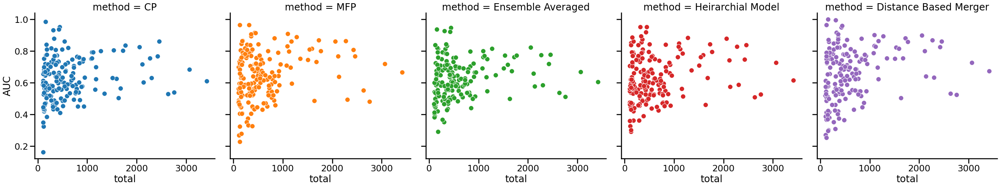

In [137]:
sns.set_context("poster")
g = sns.FacetGrid(comparison_df, col="method", row_order =order, hue="method", height=7, aspect=1)
g.map_dataframe(sns.scatterplot, x="total", y="AUC")
#g.add_legend()

/home/ss2686/miniconda3/envs/my-rdkit-env/lib/python3.9/site-packages/seaborn/distributions.py:1210: UserWarning: The following kwargs were not used by contour: 'aspect'
  cset = contour_func(


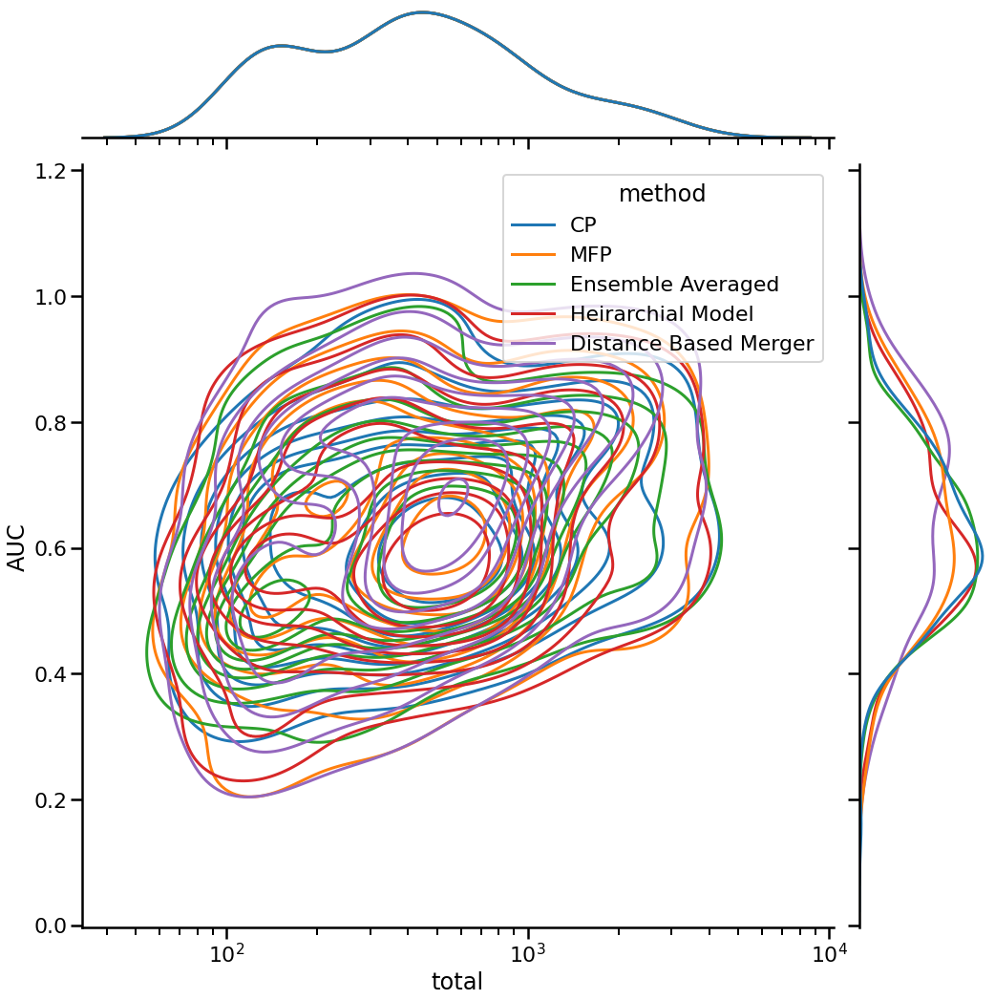

In [138]:
sns.jointplot(
    data=comparison_df,
    x="total", y="AUC", hue="method",log_scale=(True, False),kind="kde", height=15, aspect=1
)


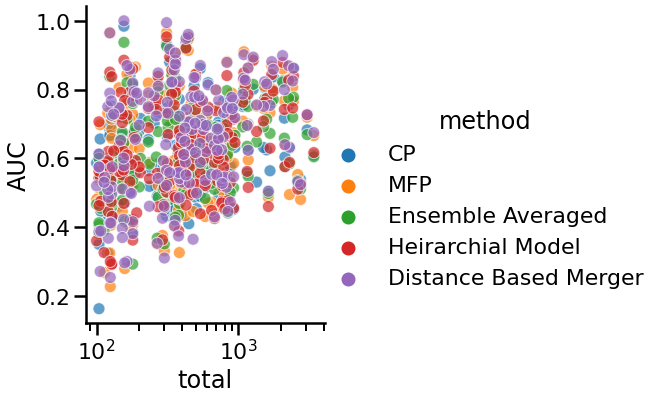

In [139]:
# Plot miles per gallon against horsepower with other semantics
g = sns.relplot( data=comparison_df, x="total", y="AUC", hue="method",
            sizes=(10, 10), alpha=.7, #palette="muted",
            height=6)
g.set(xscale="log")

In [140]:
comparison_df

,assay,method,total,ratio,AUC
0,178_684,CP,272,0.250000,0.731707
560,2685,CP,152,0.250000,0.646739
555,2642,CP,764,0.250000,0.587414
165,219_691,CP,132,0.250000,0.564286
550,2599,CP,900,0.250000,0.578436
...,...,...,...,...,...
261,241_715,Distance Based Merger,2456,0.250000,0.862317
571,449750,Distance Based Merger,158,0.626582,0.295833
156,217_688,Distance Based Merger,712,0.250000,0.685099
226,234_707,Distance Based Merger,2056,0.250000,0.898859


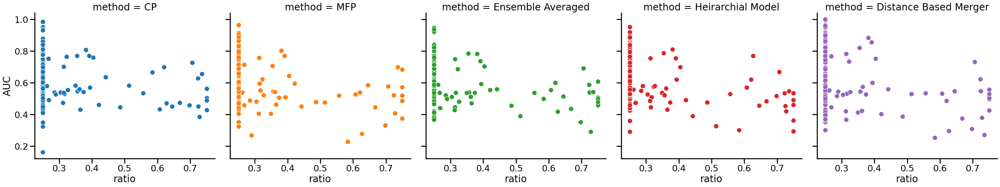

In [141]:
sns.set_context("poster")
g = sns.FacetGrid(comparison_df, col="method", row_order =order, hue="method", height=7, aspect=1)
g.map_dataframe(sns.scatterplot, x="ratio", y="AUC")
#g.add_legend()

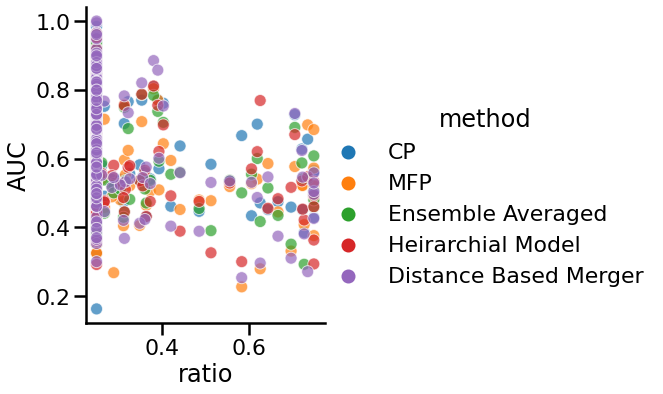

In [142]:
# Plot miles per gallon against horsepower with other semantics
g = sns.relplot( data=comparison_df, x="ratio", y="AUC", hue="method",
            sizes=(10, 10), alpha=.7, #palette="muted",
            height=6)

In [143]:
sns.set_context("paper")

<Figure size 1000x400 with 0 Axes>

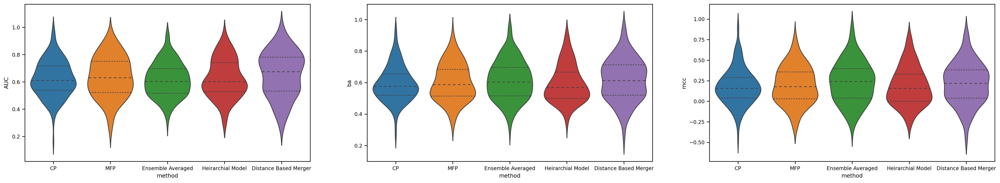

In [144]:
# Draw Plot
plt.figure(figsize=(10,4), dpi= 100)
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 5), dpi=200)

my_order=['CP', 'MFP', 'Ensemble Averaged', 'Heirarchial Model', 'Distance Based Merger']

sns.violinplot(x='method', y='AUC', data=metrics_list, scale='width', inner='quartile', order=my_order, ax=ax[0])
sns.violinplot(x='method', y='ba', data=metrics_list, scale='width', inner='quartile', order=my_order, ax=ax[1])
sns.violinplot(x='method', y='mcc', data=metrics_list, scale='width', inner='quartile', order=my_order, ax=ax[2])
#sns.violinplot(x='method', y='f1', data=metrics_list, scale='width', inner='quartile', ax=ax[1,1])
#sns.violinplot(x='method', y='precision', data=ba_df, scale='width', inner='quartile', ax=ax[2,0])
#sns.violinplot(x='method', y='Sensitivity', data=ba_df, scale='width', inner='quartile', ax=ax[2,1])
#sns.violinplot(x='method', y='Specificity', data=ba_df, scale='width', inner='quartile', ax=ax[3,0])

# Decoration
#plt.title('Performance over 92 assays', fontsize=15)
plt.show()

In [145]:
from statannotations.Annotator import Annotator

In [146]:
print("CP")
a = metrics_list[metrics_list["method"]=="CP"]["AUC"].mean()
print(a)
print("MFP")
b = metrics_list[metrics_list["method"]=="MFP"]["AUC"].mean()
print(b)
print("Distance")
c = metrics_list[metrics_list["method"]=="Distance Based Merger"]["AUC"].mean()
print(c)

CP
0.6231997000792403
MFP
0.635657183841882
Distance
0.6557664086236722


In [147]:
print("CP")
(c-a)/a

CP


0.05225725965575883

In [148]:
print("MFP")
(c-b)/b

MFP


0.0316353300064211

In [149]:
metrics_list

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC
0,178_684,CP,0.571429,0.571429,0.571429,0.853659,0.712544,0.425087,0.731707
1,178_684,Distance Based Merger,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.848432
2,178_684,Ensemble Averaged,0.521739,0.666667,0.428571,0.926829,0.677700,0.418479,0.677700
3,178_684,Heirarchial Model,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.770035
4,178_684,MFP,0.560000,0.636364,0.500000,0.902439,0.701220,0.438262,0.808362
...,...,...,...,...,...,...,...,...,...
880,Novartis2,CP,0.125000,0.142857,0.111111,0.647059,0.379085,-0.259376,0.431373
881,Novartis2,Distance Based Merger,0.307692,0.500000,0.222222,0.882353,0.552288,0.137890,0.575163
882,Novartis2,Ensemble Averaged,0.000000,0.000000,0.000000,0.941176,0.470588,-0.145521,0.470588
883,Novartis2,Heirarchial Model,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,0.431373


In [150]:
assay_ids= []
metrics_per_Assay=pd.DataFrame()
for assay in metrics_list.assay.unique():
    metrics_per_Assay = metrics_list[metrics_list["assay"]==assay]
    if((metrics_per_Assay["AUC"]>0.5).to_list().count(True)>0):
        assay_ids.append(assay)
metrics_list_2 = metrics_list[metrics_list["assay"].isin(assay_ids)]
metrics_list_2

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC
0,178_684,CP,0.571429,0.571429,0.571429,0.853659,0.712544,0.425087,0.731707
1,178_684,Distance Based Merger,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.848432
2,178_684,Ensemble Averaged,0.521739,0.666667,0.428571,0.926829,0.677700,0.418479,0.677700
3,178_684,Heirarchial Model,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.770035
4,178_684,MFP,0.560000,0.636364,0.500000,0.902439,0.701220,0.438262,0.808362
...,...,...,...,...,...,...,...,...,...
880,Novartis2,CP,0.125000,0.142857,0.111111,0.647059,0.379085,-0.259376,0.431373
881,Novartis2,Distance Based Merger,0.307692,0.500000,0.222222,0.882353,0.552288,0.137890,0.575163
882,Novartis2,Ensemble Averaged,0.000000,0.000000,0.000000,0.941176,0.470588,-0.145521,0.470588
883,Novartis2,Heirarchial Model,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,0.431373


In [151]:
len(metrics_list_2.assay.unique())

171

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

CP vs. MFP: t-test paired samples, P_val:2.531e-01 t=-1.147e+00
Heirarchial Model vs. Distance Based Merger: t-test paired samples, P_val:7.087e-05 t=-4.074e+00
Ensemble Averaged vs. Distance Based Merger: t-test paired samples, P_val:1.795e-08 t=-5.913e+00
MFP vs. Distance Based Merger: t-test paired samples, P_val:7.283e-03 t=-2.716e+00
CP vs. Distance Based Merger: t-test paired samples, P_val:5.588e-04 t=-3.518e+00


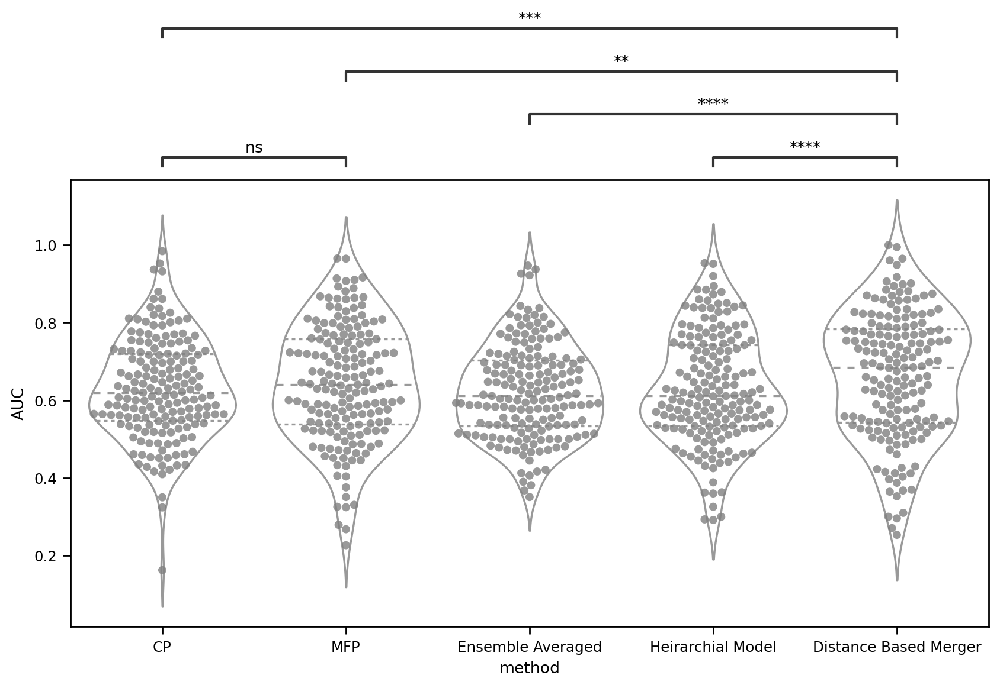

In [152]:
pairs= [('Distance Based Merger', 'CP'),
         ('CP', 'MFP'),
         ('MFP', 'Distance Based Merger'),
        ('Ensemble Averaged', 'Distance Based Merger'),
        ('Heirarchial Model', 'Distance Based Merger')]



my_order=['CP', 'MFP', 'Ensemble Averaged', 'Heirarchial Model', 'Distance Based Merger']

fig, ax = plt.subplots(figsize=(10, 5), dpi=200)

g = sns.violinplot(ax=ax,x='method', y='AUC', data=metrics_list_2, scale='width', inner='quartile', order=my_order, color="white")
g = sns.swarmplot(ax=ax,x='method', y='AUC', data=metrics_list_2, order=my_order,color="grey", alpha=0.8)

annotator = Annotator(ax=ax, pairs = pairs, data=metrics_list_2, x="method", y='AUC', order=my_order)
annotator.configure(test='t-test_paired', text_format='star', loc='outside')
annotator.apply_and_annotate()
    
plt.show()


In [153]:
assay_ids= []
metrics_per_Assay=pd.DataFrame()
for assay in metrics_list.assay.unique():
    metrics_per_Assay = metrics_list[metrics_list["assay"]==assay]
    if((metrics_per_Assay["ba"]>0.5).to_list().count(True)>0):
        assay_ids.append(assay)
metrics_list_2 = metrics_list[metrics_list["assay"].isin(assay_ids)]
metrics_list_2

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC
0,178_684,CP,0.571429,0.571429,0.571429,0.853659,0.712544,0.425087,0.731707
1,178_684,Distance Based Merger,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.848432
2,178_684,Ensemble Averaged,0.521739,0.666667,0.428571,0.926829,0.677700,0.418479,0.677700
3,178_684,Heirarchial Model,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.770035
4,178_684,MFP,0.560000,0.636364,0.500000,0.902439,0.701220,0.438262,0.808362
...,...,...,...,...,...,...,...,...,...
880,Novartis2,CP,0.125000,0.142857,0.111111,0.647059,0.379085,-0.259376,0.431373
881,Novartis2,Distance Based Merger,0.307692,0.500000,0.222222,0.882353,0.552288,0.137890,0.575163
882,Novartis2,Ensemble Averaged,0.000000,0.000000,0.000000,0.941176,0.470588,-0.145521,0.470588
883,Novartis2,Heirarchial Model,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,0.431373


In [154]:
len(metrics_list_2.assay.unique())

171

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

CP vs. MFP: t-test paired samples, P_val:2.087e-01 t=-1.262e+00
Heirarchial Model vs. Distance Based Merger: t-test paired samples, P_val:7.583e-04 t=-3.430e+00
Ensemble Averaged vs. Distance Based Merger: t-test paired samples, P_val:7.615e-01 t=-3.040e-01
MFP vs. Distance Based Merger: t-test paired samples, P_val:2.735e-02 t=-2.226e+00
CP vs. Distance Based Merger: t-test paired samples, P_val:1.116e-03 t=-3.316e+00


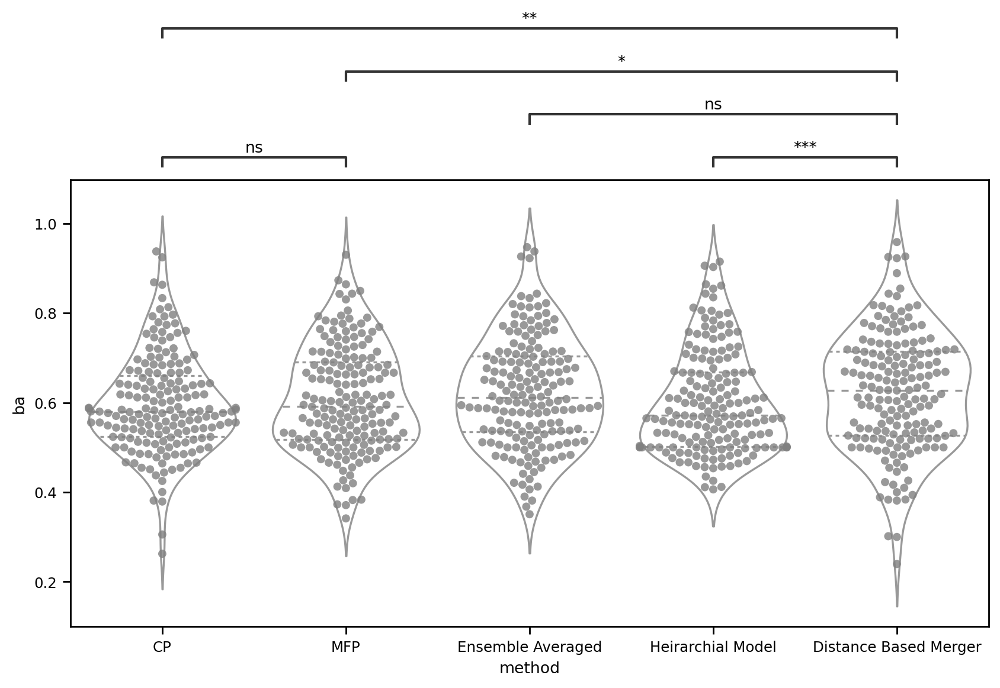

In [155]:
pairs= [('Distance Based Merger', 'CP'),
         ('CP', 'MFP'),
         ('MFP', 'Distance Based Merger'),
        ('Ensemble Averaged', 'Distance Based Merger'),
        ('Heirarchial Model', 'Distance Based Merger')]



my_order=['CP', 'MFP', 'Ensemble Averaged', 'Heirarchial Model', 'Distance Based Merger']

fig, ax = plt.subplots(figsize=(10, 5), dpi=200)

g = sns.violinplot(ax=ax,x='method', y='ba', data=metrics_list_2, scale='width', inner='quartile', order=my_order, color="white")
g = sns.swarmplot(ax=ax,x='method', y='ba', data=metrics_list_2, order=my_order,color="grey", alpha=0.8)

annotator = Annotator(ax=ax, pairs = pairs, data=metrics_list_2, x="method", y='ba', order=my_order)
annotator.configure(test='t-test_paired', text_format='star', loc='outside')
annotator.apply_and_annotate()
    
plt.show()

In [156]:
assay_ids= []
metrics_per_Assay=pd.DataFrame()
for assay in metrics_list.assay.unique():
    metrics_per_Assay = metrics_list[metrics_list["assay"]==assay]
    if((metrics_per_Assay["f1"]>0).to_list().count(True)>0):
        assay_ids.append(assay)
metrics_list_2 = metrics_list[metrics_list["assay"].isin(assay_ids)]
metrics_list_2

,assay,method,f1,precision,Sensitivity,Specificity,ba,mcc,AUC
0,178_684,CP,0.571429,0.571429,0.571429,0.853659,0.712544,0.425087,0.731707
1,178_684,Distance Based Merger,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.848432
2,178_684,Ensemble Averaged,0.521739,0.666667,0.428571,0.926829,0.677700,0.418479,0.677700
3,178_684,Heirarchial Model,0.583333,0.700000,0.500000,0.926829,0.713415,0.482063,0.770035
4,178_684,MFP,0.560000,0.636364,0.500000,0.902439,0.701220,0.438262,0.808362
...,...,...,...,...,...,...,...,...,...
880,Novartis2,CP,0.125000,0.142857,0.111111,0.647059,0.379085,-0.259376,0.431373
881,Novartis2,Distance Based Merger,0.307692,0.500000,0.222222,0.882353,0.552288,0.137890,0.575163
882,Novartis2,Ensemble Averaged,0.000000,0.000000,0.000000,0.941176,0.470588,-0.145521,0.470588
883,Novartis2,Heirarchial Model,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,0.431373


In [157]:
len(metrics_list_2.assay.unique())

177

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

CP vs. MFP: t-test paired samples, P_val:4.986e-01 t=-6.781e-01
Heirarchial Model vs. Distance Based Merger: t-test paired samples, P_val:2.280e-06 t=-4.888e+00
Ensemble Averaged vs. Distance Based Merger: t-test paired samples, P_val:1.895e-03 t=-3.154e+00
MFP vs. Distance Based Merger: t-test paired samples, P_val:6.608e-04 t=-3.467e+00
CP vs. Distance Based Merger: t-test paired samples, P_val:3.723e-05 t=-4.232e+00


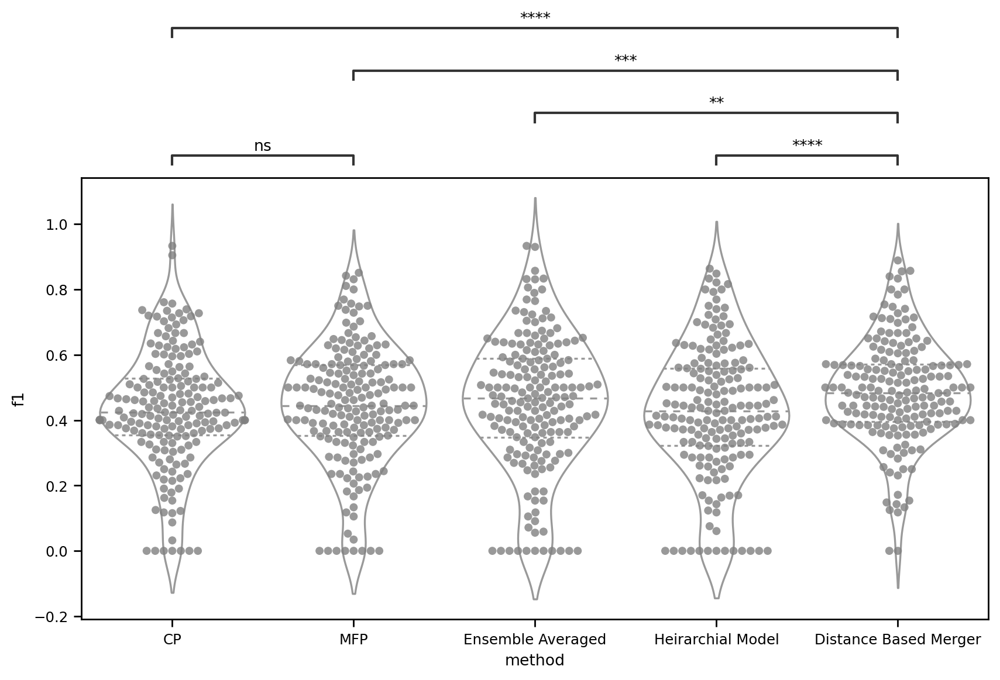

In [158]:
pairs= [('Distance Based Merger', 'CP'),
         ('CP', 'MFP'),
         ('MFP', 'Distance Based Merger'),
        ('Ensemble Averaged', 'Distance Based Merger'),
        ('Heirarchial Model', 'Distance Based Merger')]



my_order=['CP', 'MFP', 'Ensemble Averaged', 'Heirarchial Model', 'Distance Based Merger']

fig, ax = plt.subplots(figsize=(10, 5), dpi=200)

g = sns.violinplot(ax=ax,x='method', y='f1', data=metrics_list_2, scale='width', inner='quartile', order=my_order, color="white")
g = sns.swarmplot(ax=ax,x='method', y='f1', data=metrics_list_2, order=my_order,color="grey", alpha=0.8)

annotator = Annotator(ax=ax, pairs = pairs, data=metrics_list_2, x="method", y='f1', order=my_order)
annotator.configure(test='t-test_paired', text_format='star', loc='outside')
annotator.apply_and_annotate()
    
plt.show()

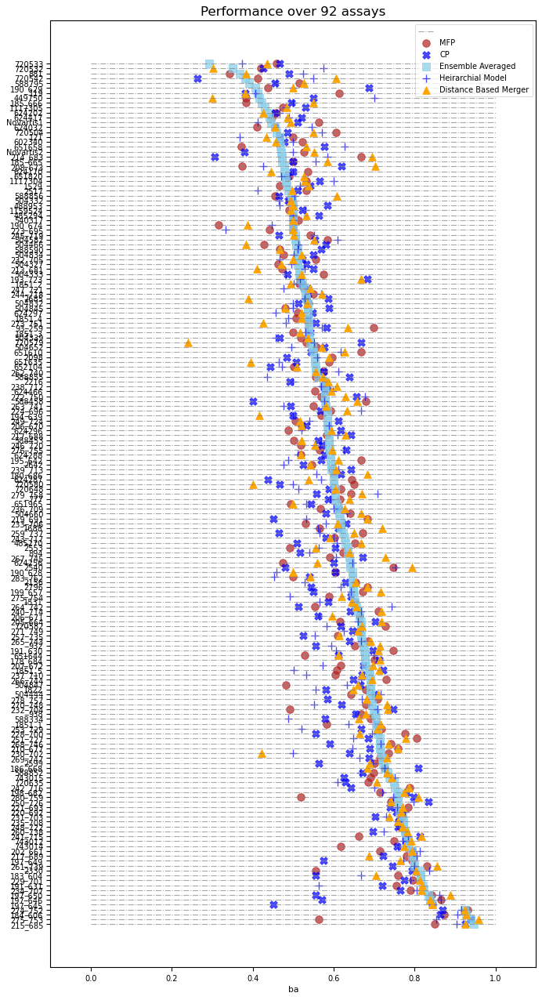

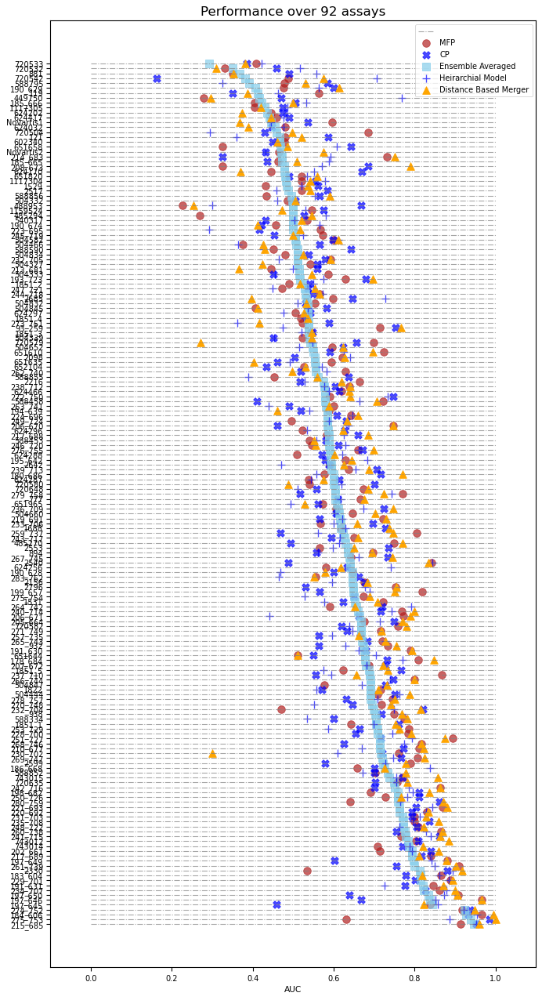

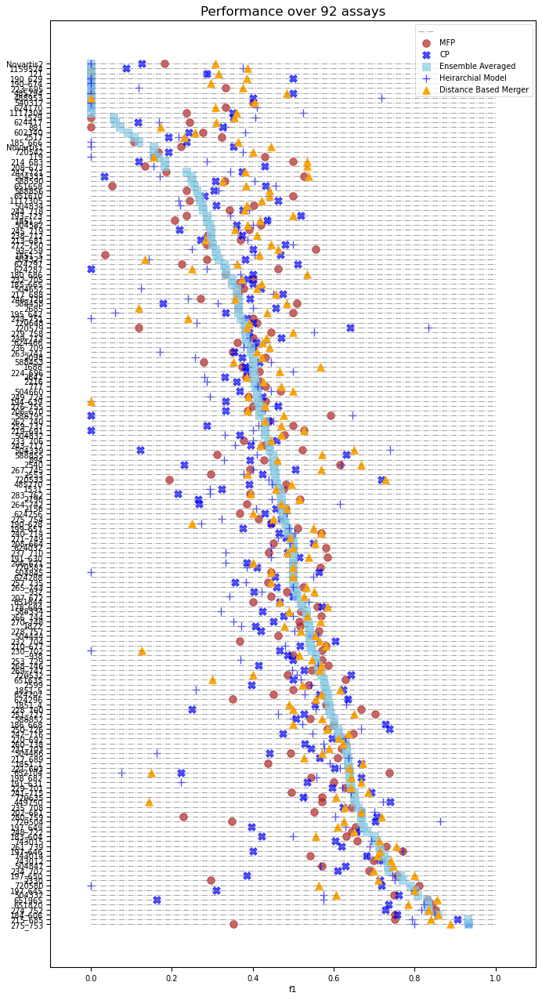

In [159]:
for metric in [ "ba", "AUC", "f1"]:
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
    improvement_df = improvement_df.sort_values(by='Ensemble Averaged', ascending=False).reset_index(drop=True)
    
    fig, ax = plt.subplots(figsize=(10,20), dpi= 80)
    
    ax.hlines(y=improvement_df.index, xmin=0, xmax=1, color='gray', alpha=0.7, linewidth=1, linestyles='dashdot')
    ax.scatter(y=improvement_df.index, x=improvement_df["MFP"], s=75, color='firebrick', alpha=0.7)
    ax.scatter(y=improvement_df.index, x=improvement_df["CP"], s=75, color='blue', alpha=0.7, marker="X")
    ax.scatter(y=improvement_df.index, x=improvement_df["Ensemble Averaged"], s=75, color='skyblue', alpha=0.7,marker="s")
    ax.scatter(y=improvement_df.index, x=improvement_df["Heirarchial Model"], s=75, color='blue', alpha=0.7,marker="+")
    ax.scatter(y=improvement_df.index, x=improvement_df["Distance Based Merger"], s=75, color='orange', alpha=1.0, marker="^")

    # Title, Label, Ticks and Ylim
    ax.set_title('Performance over 92 assays', fontdict={'size':15})
    ax.set_xlabel(metric)
    ax.set_yticks(improvement_df.index)
    ax.set_yticklabels(improvement_df.assay.str.title(), fontdict={'horizontalalignment': 'right'})
    ax.set_xlim(-.1, 1.1)
    plt.legend(["", "MFP" , "CP", "Ensemble Averaged", "Heirarchial Model", "Distance Based Merger"])
    plt.show()
    

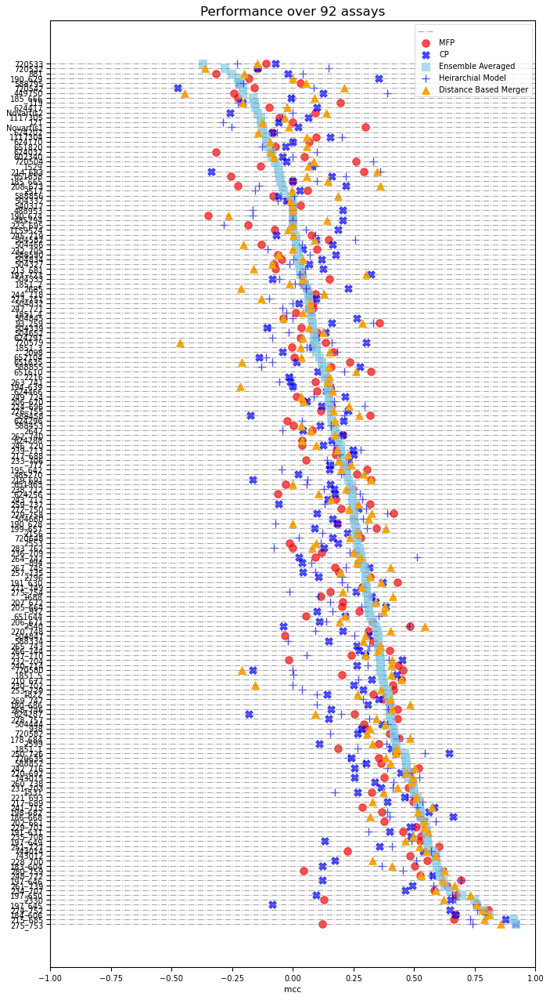

In [160]:
for metric in ["mcc"]:
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
    improvement_df = improvement_df.sort_values(by='Ensemble Averaged', ascending=False).reset_index(drop=True)
    
    fig, ax = plt.subplots(figsize=(10,20), dpi= 80)
    
    ax.hlines(y=improvement_df.index, xmin=-1, xmax=1, color='gray', alpha=0.7, linewidth=1, linestyles='dashdot')
    ax.scatter(y=improvement_df.index, x=improvement_df["MFP"], s=75, color='red', alpha=0.7)
    ax.scatter(y=improvement_df.index, x=improvement_df["CP"], s=75, color='blue', alpha=0.7, marker="X")
    ax.scatter(y=improvement_df.index, x=improvement_df["Ensemble Averaged"], s=75, color='skyblue', alpha=0.7,marker="s")
    ax.scatter(y=improvement_df.index, x=improvement_df["Heirarchial Model"], s=75, color='blue', alpha=0.7,marker="+")
    ax.scatter(y=improvement_df.index, x=improvement_df["Distance Based Merger"], s=75, color='orange', alpha=1.0, marker="^")

    # Title, Label, Ticks and Ylim
    ax.set_title('Performance over 92 assays', fontdict={'size':15})
    ax.set_xlabel(metric)
    ax.set_yticks(improvement_df.index)
    ax.set_yticklabels(improvement_df.assay.str.title(), fontdict={'horizontalalignment': 'right'})
    ax.set_xlim(-1, 1)
    plt.legend(["", "MFP" , "CP", "Ensemble Averaged", "Heirarchial Model", "Distance Based Merger"])
    plt.show()
    

ba
162
darkgreen    93
red          69
Name: colors, dtype: int64


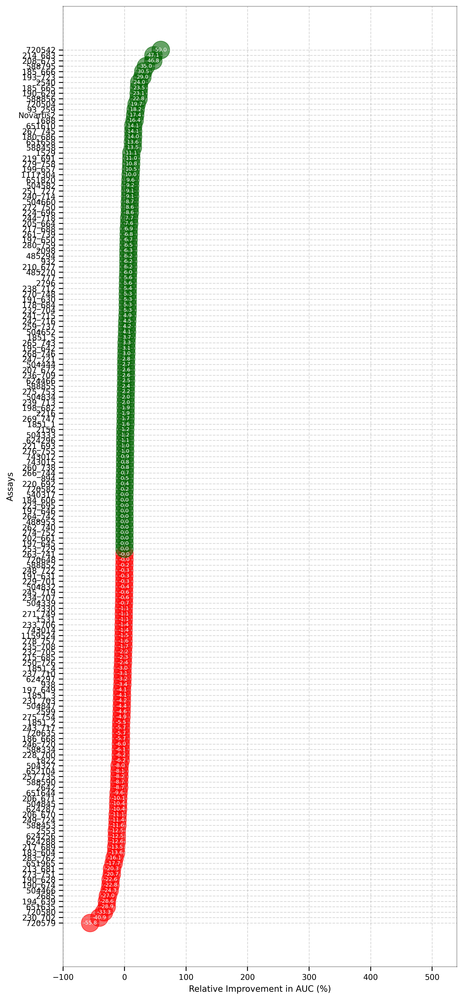

AUC
162
darkgreen    127
red           35
Name: colors, dtype: int64


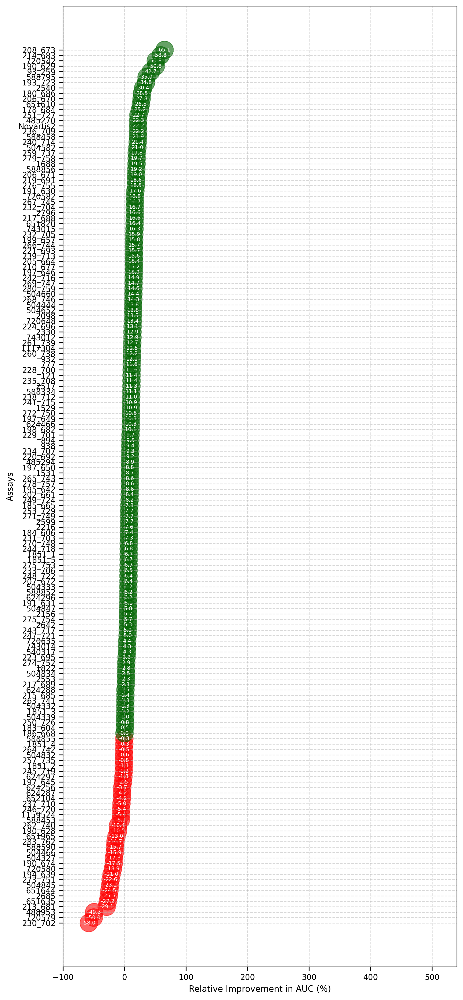

In [161]:
#Distance based improvement over ensemble

for metric in [ "ba", "AUC"]:
    
    print(metric)
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
    
    improvement_df = improvement_df[(improvement_df["Ensemble Averaged"]>=0.5) | (improvement_df["Distance Based Merger"]>=0.5)]
    
    improvement_df = improvement_df.sort_values(by='Ensemble Averaged', ascending=False).reset_index(drop=True)
    print(len(improvement_df))
    x = improvement_df.loc[:, ['Ensemble Averaged']].values
    y = improvement_df.loc[:, ['Distance Based Merger']].values
    improvement_df['mpg_z'] = ((y - x)/x)*100
    improvement_df['colors'] = ['red' if x < 0 else 'darkgreen' for x in improvement_df['mpg_z']]
    improvement_df.sort_values('mpg_z', inplace=True)
    improvement_df.reset_index(inplace=True)
    print(improvement_df["colors"].value_counts())


    plt.figure(figsize=(8,20), dpi= 300)
    plt.scatter(improvement_df.mpg_z, improvement_df.assay, s=400, alpha=.6, color=improvement_df.colors)
    for x, y, tex in zip(improvement_df.mpg_z, improvement_df.assay, improvement_df.mpg_z):
        t = plt.text(x, y, round(tex, 1), horizontalalignment='center', 
                     verticalalignment='center', fontdict={'color':'white'}, fontsize=6)

    # Decorations
    # Lighten borders
    plt.gca().spines["top"].set_alpha(.3)
    plt.gca().spines["bottom"].set_alpha(.3)
    plt.gca().spines["right"].set_alpha(.3)
    plt.gca().spines["left"].set_alpha(.3)

    plt.yticks(improvement_df.assay)
    plt.xlabel(metric)
    plt.grid(linestyle='--', alpha=0.5)
    plt.xlim(-100, 540)
    plt.xlabel("Relative Improvement in AUC (%)")
    plt.ylabel("Assays")
    plt.show()
    # Prepare Data


f1
95
darkgreen    52
red          43
Name: colors, dtype: int64


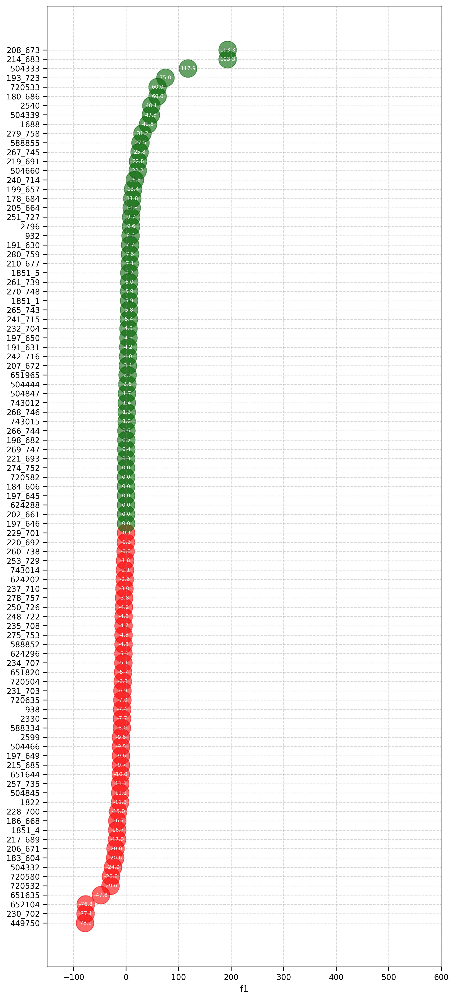

In [165]:
#Distance based improvement over ensemble

for metric in [ "f1"]:
    
    print(metric)
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
    
    improvement_df = improvement_df[(improvement_df["Ensemble Averaged"]>=0.5) | (improvement_df["Distance Based Merger"]>=0.5)]
    
    improvement_df = improvement_df.sort_values(by='Ensemble Averaged', ascending=False).reset_index(drop=True)
    print(len(improvement_df))
    x = improvement_df.loc[:, ['Ensemble Averaged']].values
    y = improvement_df.loc[:, ['Distance Based Merger']].values
    improvement_df['mpg_z'] = ((y - x)/x)*100
    improvement_df['colors'] = ['red' if x < 0 else 'darkgreen' for x in improvement_df['mpg_z']]
    improvement_df.sort_values('mpg_z', inplace=True)
    improvement_df.reset_index(inplace=True)
    print(improvement_df["colors"].value_counts())


    plt.figure(figsize=(8,20), dpi= 300)
    plt.scatter(improvement_df.mpg_z, improvement_df.assay, s=400, alpha=.6, color=improvement_df.colors)
    for x, y, tex in zip(improvement_df.mpg_z, improvement_df.assay, improvement_df.mpg_z):
        t = plt.text(x, y, round(tex, 1), horizontalalignment='center', 
                     verticalalignment='center', fontdict={'color':'white'}, fontsize=6)

    # Decorations
    # Lighten borders
    plt.gca().spines["top"].set_alpha(.3)
    plt.gca().spines["bottom"].set_alpha(.3)
    plt.gca().spines["right"].set_alpha(.3)
    plt.gca().spines["left"].set_alpha(.3)

    plt.yticks(improvement_df.assay)
    plt.xlabel(metric)
    plt.grid(linestyle='--', alpha=0.5)
    plt.xlim(-150, 600)
    plt.show()
    # Prepare Data


In [166]:
improvement_df = metrics_list[["assay","method", "f1"]]
improvement_df

,assay,method,f1
0,178_684,CP,0.571429
1,178_684,Distance Based Merger,0.583333
2,178_684,Ensemble Averaged,0.521739
3,178_684,Heirarchial Model,0.583333
4,178_684,MFP,0.560000
...,...,...,...
880,Novartis2,CP,0.125000
881,Novartis2,Distance Based Merger,0.307692
882,Novartis2,Ensemble Averaged,0.000000
883,Novartis2,Heirarchial Model,0.000000


164
darkgreen    112
red           52
Name: colors, dtype: int64


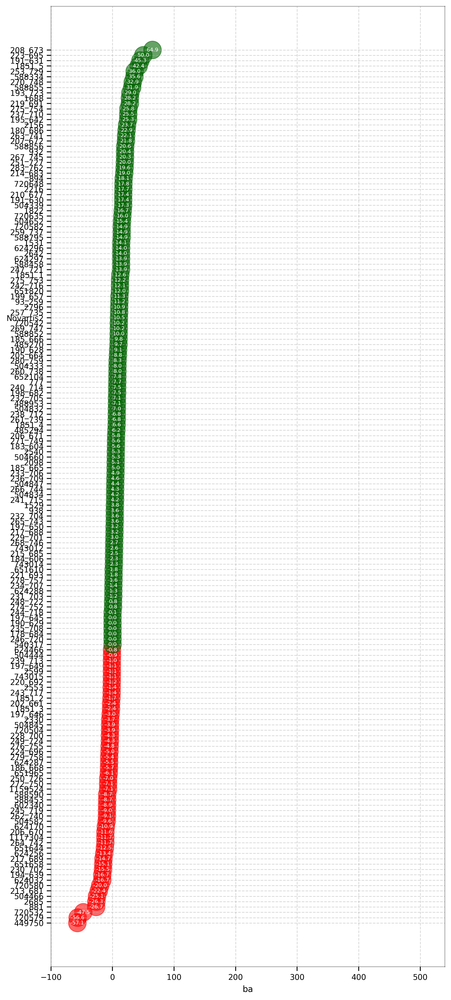

162
darkgreen    120
red           42
Name: colors, dtype: int64


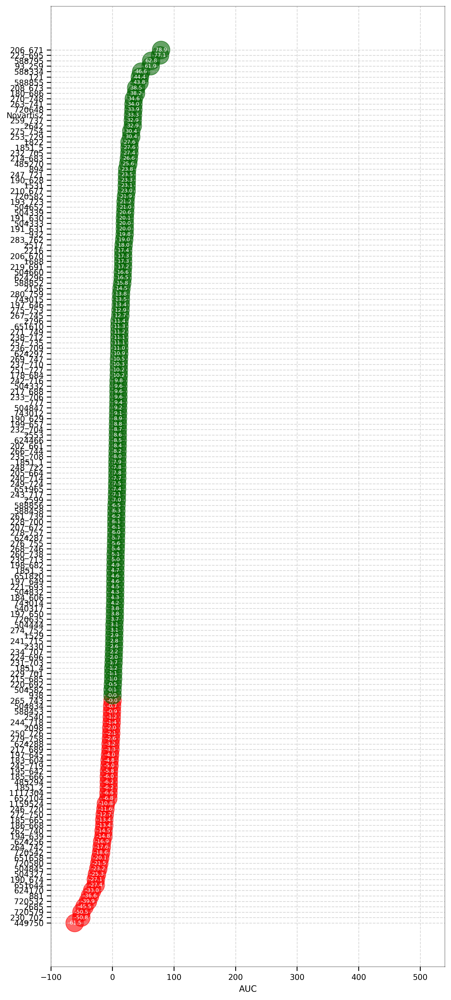

In [167]:
#Distance based improvement over heirarchial

for metric in [ "ba", "AUC"]:
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
    
    improvement_df = improvement_df[(improvement_df["Heirarchial Model"]>=0.5) | (improvement_df["Distance Based Merger"]>=0.5)]
    
    improvement_df = improvement_df.sort_values(by='Heirarchial Model', ascending=False).reset_index(drop=True)
    print(len(improvement_df))
    x = improvement_df.loc[:, ['Heirarchial Model']].values
    y = improvement_df.loc[:, ['Distance Based Merger']].values
    improvement_df['mpg_z'] = ((y - x)/x)*100
    improvement_df['colors'] = ['red' if x < 0 else 'darkgreen' for x in improvement_df['mpg_z']]
    improvement_df.sort_values('mpg_z', inplace=True)
    improvement_df.reset_index(inplace=True)
    print(improvement_df["colors"].value_counts())


    plt.figure(figsize=(8,20), dpi= 300)
    plt.scatter(improvement_df.mpg_z, improvement_df.assay, s=400, alpha=.6, color=improvement_df.colors)
    for x, y, tex in zip(improvement_df.mpg_z, improvement_df.assay, improvement_df.mpg_z):
        t = plt.text(x, y, round(tex, 1), horizontalalignment='center', 
                     verticalalignment='center', fontdict={'color':'white'}, fontsize=6)

    # Decorations
    # Lighten borders
    plt.gca().spines["top"].set_alpha(.3)
    plt.gca().spines["bottom"].set_alpha(.3)
    plt.gca().spines["right"].set_alpha(.3)
    plt.gca().spines["left"].set_alpha(.3)

    plt.yticks(improvement_df.assay)
    plt.xlabel(metric)
    plt.grid(linestyle='--', alpha=0.5)
    plt.xlim(-100, 540)
    plt.show()
    # Prepare Data


176
darkgreen    125
red           51
Name: colors, dtype: int64


/tmp/ipykernel_41234/1892203446.py:14: RuntimeWarning: divide by zero encountered in true_divide
  improvement_df['mpg_z'] = ((y - x)/x)*100
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
/home/ss2686/miniconda3/envs/my-rdkit-env/lib/python3.9/site-packages/matplotlib/transforms.py:378: RuntimeWarning: invalid value encountered in double_scalars
  return points[1, 0] - points[0, 0]
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy sh

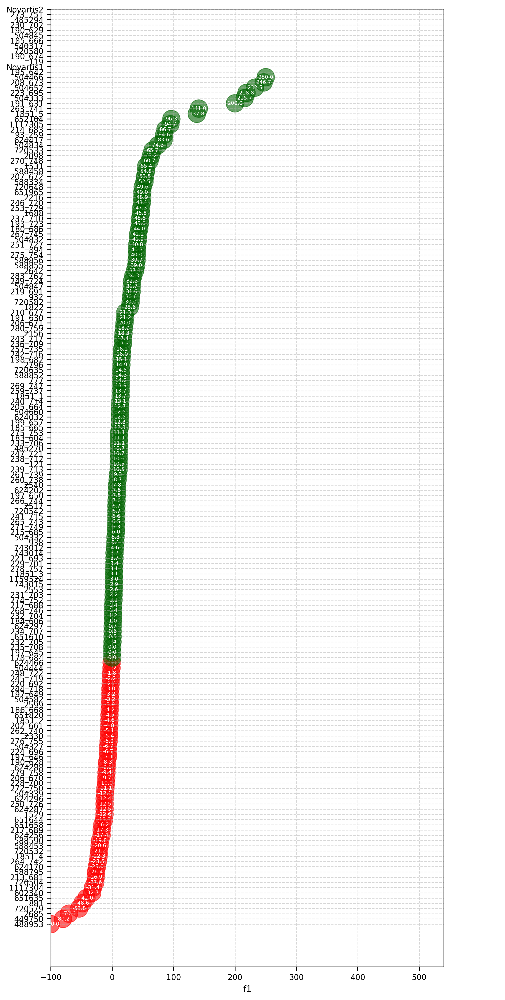

In [168]:
#Distance based improvement over heirarchial

for metric in [ "f1"]:
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
    
    improvement_df = improvement_df[(improvement_df["Heirarchial Model"]>0) | (improvement_df["Distance Based Merger"]>0)]
    
    improvement_df = improvement_df.sort_values(by='Heirarchial Model', ascending=False).reset_index(drop=True)
    print(len(improvement_df))
    x = improvement_df.loc[:, ['Heirarchial Model']].values
    y = improvement_df.loc[:, ['Distance Based Merger']].values
    improvement_df['mpg_z'] = ((y - x)/x)*100
    improvement_df['colors'] = ['red' if x < 0 else 'darkgreen' for x in improvement_df['mpg_z']]
    improvement_df.sort_values('mpg_z', inplace=True)
    improvement_df.reset_index(inplace=True)
    print(improvement_df["colors"].value_counts())


    plt.figure(figsize=(8,20), dpi= 300)
    plt.scatter(improvement_df.mpg_z, improvement_df.assay, s=400, alpha=.6, color=improvement_df.colors)
    for x, y, tex in zip(improvement_df.mpg_z, improvement_df.assay, improvement_df.mpg_z):
        t = plt.text(x, y, round(tex, 1), horizontalalignment='center', 
                     verticalalignment='center', fontdict={'color':'white'}, fontsize=6)

    # Decorations
    # Lighten borders
    plt.gca().spines["top"].set_alpha(.3)
    plt.gca().spines["bottom"].set_alpha(.3)
    plt.gca().spines["right"].set_alpha(.3)
    plt.gca().spines["left"].set_alpha(.3)

    plt.yticks(improvement_df.assay)
    plt.xlabel(metric)
    plt.grid(linestyle='--', alpha=0.5)
    plt.xlim(-100, 540)
    plt.show()
    # Prepare Data


167
darkgreen    107
red           60
Name: colors, dtype: int64


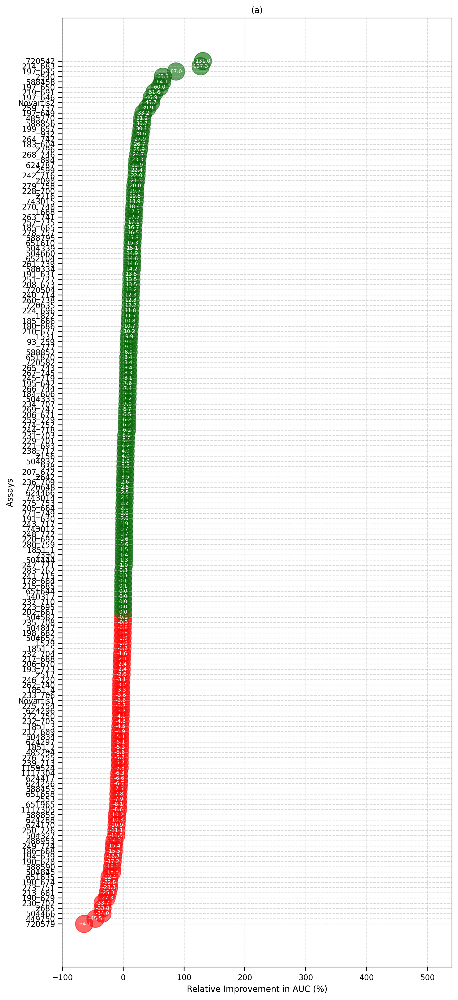

163
darkgreen    114
red           49
Name: colors, dtype: int64


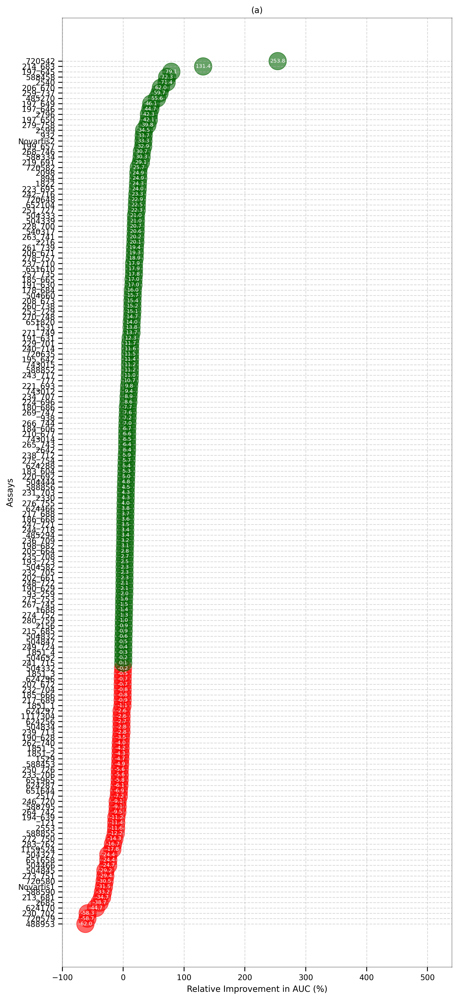

In [169]:
#Distance based improvement over CP

for metric in [ "ba", "AUC"]:
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
    
    improvement_df = improvement_df[(improvement_df["CP"]>=0.5) | (improvement_df["Distance Based Merger"]>=0.5)]
    
    improvement_df = improvement_df.sort_values(by='Distance Based Merger', ascending=False).reset_index(drop=True)
    
    print(len(improvement_df))
    x = improvement_df.loc[:, ['CP']].values
    y = improvement_df.loc[:, ['Distance Based Merger']].values
    improvement_df['mpg_z'] = ((y - x)/x)*100
    improvement_df['colors'] = ['red' if x < 0 else 'darkgreen' for x in improvement_df['mpg_z']]
    improvement_df.sort_values('mpg_z', inplace=True)
    improvement_df.reset_index(inplace=True)
    print(improvement_df["colors"].value_counts())


    plt.figure(figsize=(8,20), dpi= 300)
    plt.scatter(improvement_df.mpg_z, improvement_df.assay, s=400, alpha=.6, color=improvement_df.colors)
    for x, y, tex in zip(improvement_df.mpg_z, improvement_df.assay, improvement_df.mpg_z):
        t = plt.text(x, y, round(tex, 1), horizontalalignment='center', 
                     verticalalignment='center', fontdict={'color':'white'}, fontsize=6)

    # Decorations
    # Lighten borders
    plt.gca().spines["top"].set_alpha(.3)
    plt.gca().spines["bottom"].set_alpha(.3)
    plt.gca().spines["right"].set_alpha(.3)
    plt.gca().spines["left"].set_alpha(.3)

    plt.yticks(improvement_df.assay)
    plt.grid(linestyle='--', alpha=0.5)
    plt.title("(a)")
    plt.xlabel("Relative Improvement in AUC (%)")
    plt.ylabel("Assays")
    plt.xlim(-100, 540)
    plt.show()
    # Prepare Data

161
darkgreen    102
red           59
Name: colors, dtype: int64


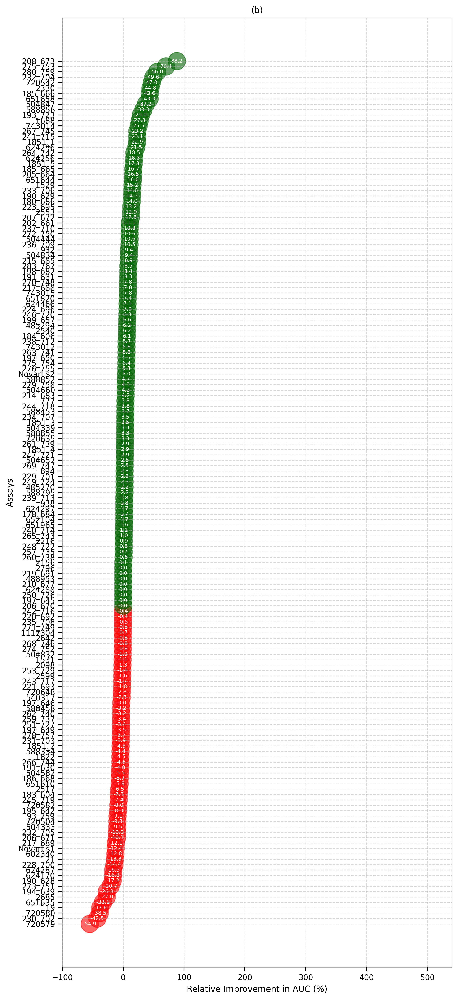

159
darkgreen    113
red           46
Name: colors, dtype: int64


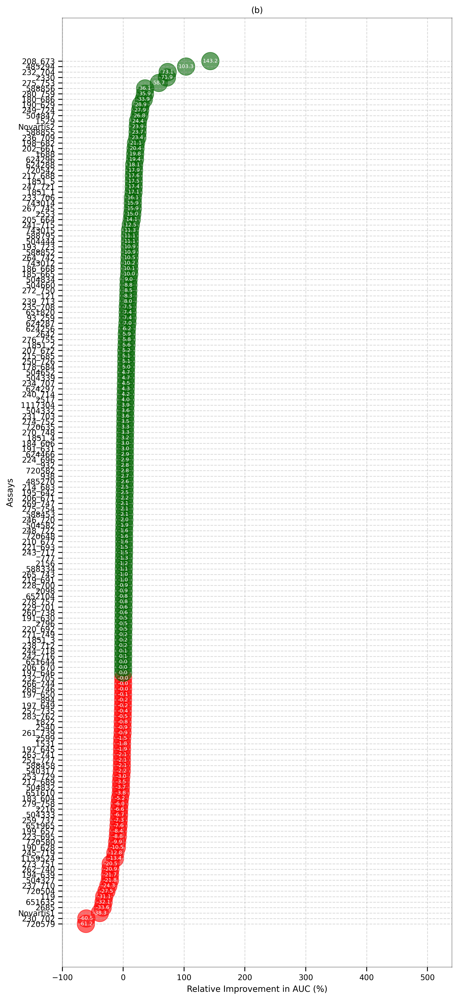

In [170]:
#Distance based improvement over MFP

for metric in [ "ba", "AUC"]:
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
   
    improvement_df = improvement_df[(improvement_df["MFP"]>=0.5) | (improvement_df["Distance Based Merger"]>=0.5)]
    
    improvement_df = improvement_df.sort_values(by='Distance Based Merger', ascending=False).reset_index(drop=True)
    
    print(len(improvement_df))
    
    x = improvement_df.loc[:, ['MFP']].values
    y = improvement_df.loc[:, ['Distance Based Merger']].values
    improvement_df['mpg_z'] = ((y - x)/x)*100
    improvement_df['colors'] = ['red' if x < 0 else 'darkgreen' for x in improvement_df['mpg_z']]
    improvement_df.sort_values('mpg_z', inplace=True)
    improvement_df.reset_index(inplace=True)
    print(improvement_df["colors"].value_counts())


    plt.figure(figsize=(8,20), dpi= 300)
    plt.scatter(improvement_df.mpg_z, improvement_df.assay, s=400, alpha=.6, color=improvement_df.colors)
    for x, y, tex in zip(improvement_df.mpg_z, improvement_df.assay, improvement_df.mpg_z):
        t = plt.text(x, y, round(tex, 1), horizontalalignment='center', 
                     verticalalignment='center', fontdict={'color':'white'}, fontsize=6)

    # Decorations
    # Lighten borders
    plt.gca().spines["top"].set_alpha(.3)
    plt.gca().spines["bottom"].set_alpha(.3)
    plt.gca().spines["right"].set_alpha(.3)
    plt.gca().spines["left"].set_alpha(.3)

    plt.yticks(improvement_df.assay)
    plt.xlabel(metric)
    plt.grid(linestyle='--', alpha=0.5)
    plt.title("(b)")
    plt.xlabel("Relative Improvement in AUC (%)")
    plt.ylabel("Assays")
    plt.xlim(-100, 540)
    plt.show()
    # Prepare Data

167
darkgreen    107
red           60
Name: colors, dtype: int64


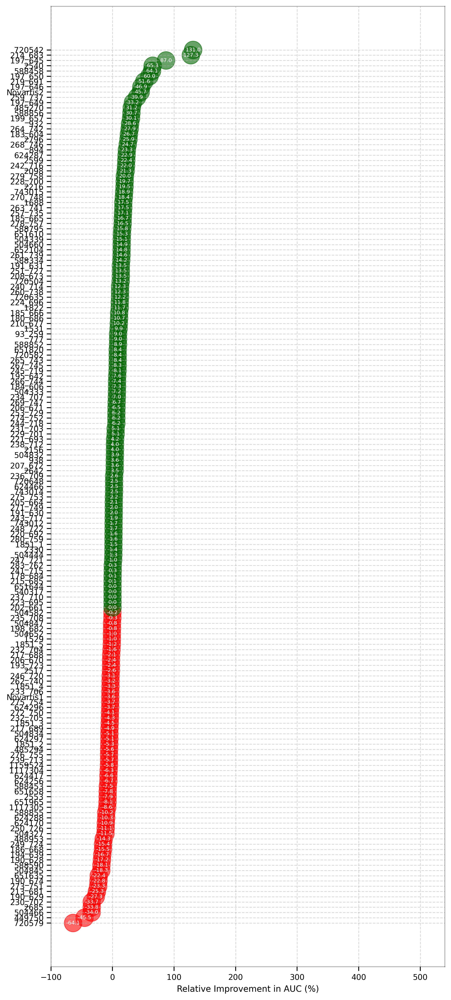

163
darkgreen    114
red           49
Name: colors, dtype: int64


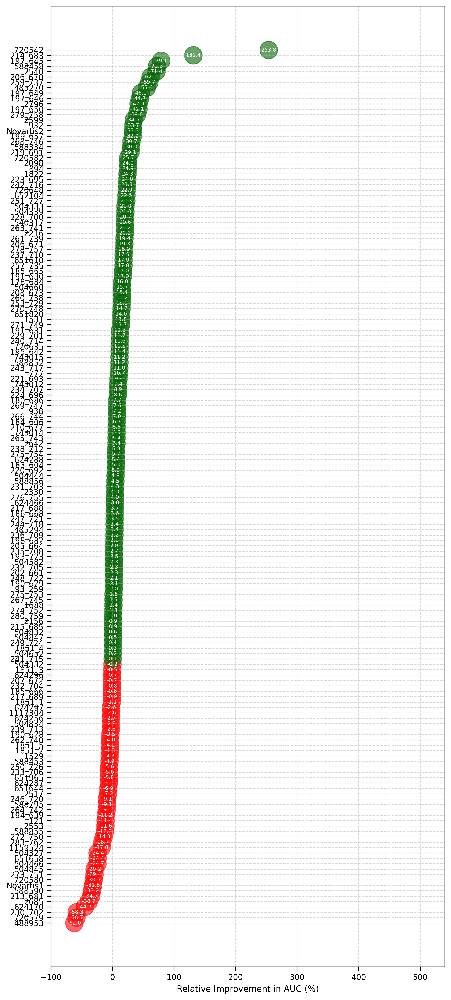

In [172]:
#Distance based improvement over CP

for metric in [ "ba", "AUC"]:
    
    improvement_df = metrics_list[["assay","method", metric]]
    improvement_df = improvement_df.pivot(index='assay', columns='method', values=metric).reset_index(drop=False)
   
    improvement_df = improvement_df[(improvement_df["CP"]>=0.5) | (improvement_df["Distance Based Merger"]>=0.5)]
    
    improvement_df = improvement_df.sort_values(by='Distance Based Merger', ascending=False).reset_index(drop=True)
    
    print(len(improvement_df))
    
    x = improvement_df.loc[:, ['CP']].values
    y = improvement_df.loc[:, ['Distance Based Merger']].values
    improvement_df['mpg_z'] = ((y - x)/x)*100
    improvement_df['colors'] = ['red' if x < 0 else 'darkgreen' for x in improvement_df['mpg_z']]
    improvement_df.sort_values('mpg_z', inplace=True)
    improvement_df.reset_index(inplace=True)
    print(improvement_df["colors"].value_counts())


    plt.figure(figsize=(8,20), dpi= 300)
    plt.scatter(improvement_df.mpg_z, improvement_df.assay, s=400, alpha=.6, color=improvement_df.colors)
    for x, y, tex in zip(improvement_df.mpg_z, improvement_df.assay, improvement_df.mpg_z):
        t = plt.text(x, y, round(tex, 1), horizontalalignment='center', 
                     verticalalignment='center', fontdict={'color':'white'}, fontsize=6)

    # Decorations
    # Lighten borders
    plt.gca().spines["top"].set_alpha(.3)
    plt.gca().spines["bottom"].set_alpha(.3)
    plt.gca().spines["right"].set_alpha(.3)
    plt.gca().spines["left"].set_alpha(.3)

    plt.yticks(improvement_df.assay)
    plt.xlabel("Relative Improvement in AUC (%)")
    plt.grid(linestyle='--', alpha=0.5)
    plt.xlim(-100, 540)
    plt.show()
    # Prepare Data